In [4]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix

import scipy.io
from scipy.linalg import svd

import matplotlib.cm as cm

In [5]:
class Network():
    def __init__(self, sizes):
        self.num_layers = len(sizes)
        self.sizes = sizes
        self.biases = [np.random.randn(y, 1) for y in sizes[1:]]
        self.weights = [np.random.randn(y, x) for x, y in zip(sizes[:-1], sizes[1:])]
        
        #self.biases = [np.zeros((y, 1)) for y in sizes[1:]]
        #self.weights = [np.zeros((y, x)) for x, y in zip(sizes[:-1], sizes[1:])]
    
    def feedforward(self, a):
        a = a.reshape(-1, 1)
        """ Return the output of the network for a given input a"""
        count = 1
        for b, w, in zip(self.biases, self.weights):
            
            if(count == len(self.weights)):
                a = softmax(np.dot(w, a) + b)
                
            else:
                a = sigmoid(np.dot(w, a) + b)
                
            count += 1

        
        return a
    
    def SGD(self, training_data, epochs, mini_batch_size, eta, test_data = None):
        
        if test_data:
            n_test = len(test_data)
        n = len(training_data)
        
        for j in range(epochs):
            np.random.shuffle(training_data)
            
            mini_batches = [training_data[k: k + mini_batch_size] for k in range(0, n, mini_batch_size)]
            
            for mini_batch in mini_batches:
                self.update_mini_batch(mini_batch, eta)
            
            if test_data:
                print("Epoch {0}: {1} / {2}".format(j, self.evaluate(test_data), n_test))
            
            else:
                print("Epoch {0} complete".format(j))
                
        print("Completed")
                
    def update_mini_batch(self, mini_batch, eta):
        
        nabla_b = [np.zeros(b.shape) for b in self.biases]
        nabla_w = [np.zeros(w.shape) for w in self.weights]
        
        for x, y in mini_batch:

            delta_nabla_b, delta_nabla_w = self.backprop(x.reshape(-1,1), y.reshape(-1,1))
            print("Gradients = ",delta_nabla_w, "Biases = ", delta_nabla_b)    
            nabla_b = [nb + dnb for nb, dnb in zip(nabla_b, delta_nabla_b)]
            nabla_w = [nw + dnw for nw, dnw in zip(nabla_w, delta_nabla_w)]
        
        self.weights = [w - eta/len(mini_batch) * nw  for w, nw in zip(self.weights, nabla_w)]
        
        self.biases = [b - eta/len(mini_batch) * nb for b, nb in zip(self.biases, nabla_b)]
        
    
    def backprop(self, x, y):

        nabla_b = [np.zeros(b.shape) for b in self.biases]
        nabla_w = [np.zeros(w.shape) for w in self.weights]
        
        """Feed Forward"""
       
        activation = x
        activations = [x] #list of activations layer by layer
        
        zs = [] # list of pre-activations layer by layer
        
        count = 1
        for b, w in zip(self.biases, self.weights):
            

            z = np.dot(w, activation) + b
            
            zs.append(z)
            
            if count == len(self.weights):
                activation = softmax(z)  
            
            else:
                activation = sigmoid(z)
                
                
                
            activations.append(activation)
            
            count += 1
        
        
        print("Forward Pass activations= ", activations, "and Preactivations = ", zs)    
        """Backward pass"""

        delta = self.cost_derivative(activations[-1], y)

        nabla_b[-1] = delta
        nabla_w[-1] = np.dot(delta, activations[-2].transpose())
        
        for l in range(2, self.num_layers):
            
            z = zs[-l]
            sp = sigmoid_prime(z)
            delta = np.dot(self.weights[-l + 1].T, delta) * sp
            nabla_b[-l] = delta
            
            nabla_w[-l] = np.dot(delta, activations[-l-1].transpose())

        return (nabla_b, nabla_w)
    
    def cost_derivative(self, output_activation, y):

        return (output_activation - y)
    
    
    def evaluate(self, test_data, actual_values):
        
        predicted_values = np.apply_along_axis(self.feedforward, 1, test_data)
        
        return confusion_matrix(np.argmax(actual_values, axis = 1), np.argmax(predicted_values, axis = 1))
        
    

def sigmoid(z):
    #print("Sigmoid = ", z)
    z = np.clip(z, -500, 500)
    
    return (1.0/(1.0 + np.exp(-z)))

def sigmoid_prime(z):
    #print("sigmoid Prime = ", z)
    z = np.clip(z, -500, 500)
    return (sigmoid(z) * (1 - sigmoid(z)))

def softmax(z):
    
#   np.clip(z, -500, 500)
    z = z - np.max(z)
    temp = []
    for index, each_pre_activation in enumerate(z):
        
        temp.append( np.exp(each_pre_activation)/np.exp(z).sum() )
    
    return np.array(temp)

In [6]:
Iris = pd.read_csv('../Dimentionality Reduction/LDA/Iris.csv')
Iris.head()

,Id,SepalLengthCm,SepalWidthCm,PetalLengthCm,PetalWidthCm,Species
0,1,5.1,3.5,1.4,0.2,Iris-setosa
1,2,4.9,3.0,1.4,0.2,Iris-setosa
2,3,4.7,3.2,1.3,0.2,Iris-setosa
3,4,4.6,3.1,1.5,0.2,Iris-setosa
4,5,5.0,3.6,1.4,0.2,Iris-setosa


In [7]:
# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')

# passing bridge-types-cat column (label encoded values of bridge_types)
enc_df = pd.DataFrame(enc.fit_transform(Iris[['Species']]).toarray())

# merge with main df bridge_df on key values
Iris = Iris.join(enc_df)


In [8]:
Iris = Iris.sample(frac = 1)

In [9]:
Iris  = Iris.rename({0: 'Iris-setosa', 1: 'Iris-versicolor', 2: 'Iris-virginica'}, axis=1)

In [10]:
Xtrain = Iris[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']]
Ytrain = Iris[['Iris-setosa', 'Iris-versicolor', 'Iris-virginica']]

In [11]:
scaler = StandardScaler()
Xtrain = scaler.fit_transform(Xtrain)

In [12]:
Ytrain = np.array(Ytrain)

In [13]:
Xtrain = Xtrain[:10]
Ytrain = Ytrain[:10]

In [14]:
train_set = list(zip(Xtrain, Ytrain))

In [20]:
net = Network([4, 10, 3])

In [21]:
net.SGD(train_set, 30, 150, 1)

Forward Pass activations=  [array([[-0.17367395],
       [-0.58776353],
       [ 0.1941016 ],
       [ 0.13322594]]), array([[0.22033677],
       [0.29211706],
       [0.27616393],
       [0.60399747],
       [0.71329157],
       [0.28546474],
       [0.44113336],
       [0.77502261],
       [0.50549169],
       [0.50779296],
       [0.09679698],
       [0.19195386],
       [0.50305211],
       [0.87220348],
       [0.64805423],
       [0.88584376],
       [0.32450065],
       [0.52064649],
       [0.32268465],
       [0.81197681],
       [0.36518736],
       [0.16746851],
       [0.66446032],
       [0.33074209],
       [0.40881404],
       [0.37646576],
       [0.88670811],
       [0.2989888 ],
       [0.28926631],
       [0.47515101],
       [0.64669851],
       [0.68392683],
       [0.36862042],
       [0.72947618],
       [0.8151944 ],
       [0.51537191],
       [0.66979872],
       [0.34333398],
       [0.56598708],
       [0.5294957 ],
       [0.67233853],
       [0.22731259],


       [4.47147808e-22]])] and Preactivations =  [array([[-1.35594769e+00],
       [-7.70843353e-01],
       [-7.20539347e-01],
       [ 5.78862803e-01],
       [ 1.41647546e+00],
       [-1.37821812e+00],
       [-5.35417338e-01],
       [ 1.46713830e+00],
       [ 6.00908424e-02],
       [-2.90334197e-01],
       [-2.62851696e+00],
       [-1.26107773e+00],
       [-3.63241853e-01],
       [ 1.95503463e+00],
       [ 1.00949961e+00],
       [ 2.17578924e+00],
       [-4.82575688e-01],
       [ 1.31996636e-01],
       [-4.74394767e-01],
       [ 1.58339990e+00],
       [-6.88283585e-01],
       [-1.92039440e+00],
       [ 5.85304219e-01],
       [-8.15750281e-01],
       [-9.09005994e-01],
       [-6.58728724e-01],
       [ 2.62344308e+00],
       [-1.41708959e+00],
       [-1.06561668e+00],
       [-1.24623718e-01],
       [ 5.37866725e-01],
       [ 7.44076184e-01],
       [-4.90279815e-01],
       [ 1.24345809e+00],
       [ 2.04006524e+00],
       [-2.85624435e-02],
       [ 6.691

        -3.05803723e-02, -8.81267485e-01, -7.61393923e-01]])] Biases =  [array([[ 3.06239381e-01],
       [-1.36243079e-03],
       [ 2.24790794e-03],
       [ 1.87729572e-01],
       [-7.96399987e-01],
       [ 3.92254299e-02],
       [ 9.77671952e-03],
       [-3.87970917e-01],
       [ 1.77856120e-01],
       [ 1.97194262e-01],
       [ 2.98062029e-01],
       [-6.54403258e-03],
       [-4.64106763e-01],
       [-1.97259417e-01],
       [ 1.96763854e-01],
       [-1.10928853e-03],
       [-2.27972658e-02],
       [ 9.64472954e-02],
       [ 1.50784814e-01],
       [-1.69421972e-01],
       [ 4.13815912e-01],
       [ 2.56249765e-02],
       [ 4.59119251e-02],
       [ 4.21181290e-02],
       [ 1.56257171e-03],
       [ 2.19350134e-04],
       [ 7.61266603e-02],
       [ 9.82652937e-02],
       [ 1.46468803e-01],
       [ 1.15285423e-02],
       [ 5.39220061e-02],
       [-8.69652772e-04],
       [ 7.60466618e-03],
       [-4.34872777e-01],
       [-1.24707696e-01],
       [ 4.179853

         2.93828759e-26,  3.58493774e-26,  1.14960844e-25]])] Biases =  [array([[ 6.28353401e-02],
       [-1.36782718e-01],
       [-2.81703746e-01],
       [ 4.46422681e-01],
       [-3.06735721e-01],
       [-2.52092545e-01],
       [ 1.88203880e-01],
       [-1.27122621e-01],
       [ 4.41115443e-01],
       [ 1.92578102e-01],
       [-7.55569007e-02],
       [ 6.97292469e-02],
       [-6.63440014e-02],
       [-1.61281846e-02],
       [-6.64622968e-03],
       [-3.82949256e-02],
       [-1.24622341e-01],
       [-2.99385574e-01],
       [ 1.10017294e-01],
       [-8.08266174e-02],
       [ 3.19550750e-01],
       [-4.92431200e-02],
       [ 1.97137780e-01],
       [ 8.51425309e-02],
       [ 1.60987638e-02],
       [-1.75487666e-01],
       [-1.63215604e-02],
       [ 2.48370409e-01],
       [ 1.36162904e-01],
       [ 3.08330255e-01],
       [ 2.31163913e-02],
       [-1.13827430e-02],
       [-3.35421129e-01],
       [-5.33558687e-01],
       [ 9.73819381e-02],
       [ 2.372879

       [4.52810217e-027]])] and Preactivations =  [array([[-7.43864245e-01],
       [-3.16248032e+00],
       [-3.06509045e+00],
       [-1.18759657e+00],
       [-1.94297156e-01],
       [ 1.38559176e+00],
       [ 1.97685197e+00],
       [ 8.53641593e-01],
       [-9.62612095e-01],
       [ 1.15175572e-01],
       [-1.03470203e+00],
       [-5.84208075e-01],
       [ 1.31564004e+00],
       [ 5.11488302e-01],
       [ 8.35173219e-02],
       [ 3.19696489e+00],
       [-2.06002522e+00],
       [-3.20616055e-01],
       [-1.60266259e+00],
       [ 1.36831449e+00],
       [-7.14495531e-01],
       [-2.64027794e-02],
       [ 3.89991858e-01],
       [ 8.50697048e-01],
       [ 3.60982215e+00],
       [ 1.63321733e+00],
       [-2.87447204e-02],
       [ 8.39951290e-01],
       [-1.96777556e-01],
       [-1.45779507e+00],
       [ 1.23475338e+00],
       [ 1.61342440e+00],
       [-1.92144197e+00],
       [ 8.50479821e-01],
       [-3.42577342e-01],
       [-5.21277295e-01],
       [ 2.38

        9.50476958e-042, 2.88670749e-041, 6.65027826e-041]])] Biases =  [array([[-5.81694216e-42],
       [-1.06437811e-41],
       [-5.18657928e-42],
       [-2.36165607e-41],
       [ 1.90956532e-41],
       [-5.26194231e-42],
       [-5.27026626e-41],
       [ 1.37123133e-41],
       [-1.19827265e-41],
       [-3.52701090e-41],
       [-4.50943632e-42],
       [ 1.00175831e-41],
       [ 1.99823789e-41],
       [ 5.83939817e-42],
       [-8.46523727e-42],
       [ 1.13179079e-41],
       [-1.11072977e-42],
       [-2.30199900e-41],
       [-1.14498860e-42],
       [ 8.19418035e-42],
       [-3.78600328e-42],
       [-7.58787281e-42],
       [ 2.62129430e-41],
       [-8.51917454e-42],
       [-2.27908400e-41],
       [ 9.09572928e-42],
       [-5.11620240e-42],
       [-6.31723319e-42],
       [ 5.50718955e-42],
       [-5.99529467e-42],
       [ 7.11516016e-42],
       [-6.66857777e-43],
       [-2.30833486e-41],
       [-3.50305437e-42],
       [ 8.50070253e-42],
       [-1.020033

         3.20862121e-46,  2.25742971e-47,  1.02928258e-45]])] Biases =  [array([[-7.59009310e-03],
       [ 9.75422237e-02],
       [ 3.50172660e-01],
       [-2.10673976e-01],
       [ 7.92721052e-02],
       [ 5.10593729e-01],
       [-3.91401552e-02],
       [ 1.93147185e-01],
       [-3.00550215e-01],
       [-4.19867839e-04],
       [ 2.85523826e-01],
       [-5.54834686e-03],
       [ 1.08372653e-02],
       [ 1.09877968e-01],
       [ 2.81878598e-02],
       [ 5.56177976e-02],
       [ 1.43816963e-01],
       [ 2.56117417e-01],
       [-2.56760208e-02],
       [ 2.25722902e-01],
       [-1.87609536e-01],
       [ 1.52390525e-01],
       [-8.02545091e-04],
       [ 3.49289858e-03],
       [ 1.41212759e-01],
       [ 3.61360049e-01],
       [ 6.04011192e-03],
       [-1.52034998e-02],
       [-9.36821574e-02],
       [-3.45117970e-02],
       [ 1.94301285e-01],
       [ 5.17898264e-02],
       [ 4.07730942e-01],
       [ 8.43205661e-01],
       [-1.02767903e-03],
       [ 1.221934

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[4.46674128e-01],
       [1.66362598e-03],
       [2.80215903e-03],
       [1.93663328e-02],
       [8.47361121e-01],
       [9.03045475e-01],
       [9.92665439e-01],
       [9.55616539e-01],
       [3.67340545e-01],
       [6.28641114e-02],
       [1.37213911e-01],
       [8.85593985e-01],
       [7.39246071e-01],
       [4.16990879e-01],
       [6.89098285e-01],
       [9.99295184e-01],
       [3.90321397e-02],
       [6.75662388e-01],
       [7.06444137e-02],
       [7.10842193e-01],
       [1.34425708e-01],
       [4.31295265e-01],
       [9.73399422e-02],
       [9.51832566e-01],
       [9.98799746e-01],
       [9.46952057e-01],
       [8.82608622e-01],
       [5.69725372e-01],
       [1.72882139e-01],
       [1.11804385e-02],
       [9.49424630e-01],
       [9.90952409e-01],
       [1.36739723e-02],
       [9.28062617e-01],
       [8.27861382e-01],
       

         1.16001379e-001,  3.90441608e-001,  8.46786805e-001]])] Biases =  [array([[-9.69580096e-02],
       [ 1.36535402e-01],
       [-4.37175246e-01],
       [-1.94496386e-01],
       [ 1.68605924e-01],
       [-2.85499993e-01],
       [-2.08391743e-01],
       [ 3.25407933e-01],
       [ 3.61562682e-01],
       [-1.92574807e-01],
       [-1.44817199e-01],
       [ 2.05705601e-01],
       [ 5.02659914e-01],
       [ 1.00485584e-01],
       [-2.65792999e-01],
       [ 1.41216225e-01],
       [ 1.02800909e-01],
       [-3.25738095e-01],
       [-2.05154306e-01],
       [ 7.60286865e-02],
       [-3.83540521e-02],
       [-6.22083388e-02],
       [ 1.08858997e-01],
       [-1.42616810e-01],
       [-2.58854688e-01],
       [-2.30293950e-01],
       [-5.59384086e-02],
       [ 2.51767291e-01],
       [ 2.16151361e-02],
       [ 1.63856076e-01],
       [-2.02179471e-01],
       [ 1.18625418e-01],
       [-4.42984365e-01],
       [-4.78312750e-02],
       [ 2.10403415e-01],
       [-3.384

         1.28919431e-01,  1.22380898e-02,  6.77123560e-01]])] Biases =  [array([[-8.76467341e-02],
       [ 8.04763115e-02],
       [-1.19499429e-01],
       [-1.19378018e-01],
       [ 6.56920067e-01],
       [ 3.30670384e-02],
       [-3.99165515e-02],
       [ 5.63174845e-01],
       [-9.48710082e-03],
       [-1.72440084e-02],
       [-2.52634904e-01],
       [ 1.32566181e-02],
       [ 2.53921074e-01],
       [ 2.00051625e-01],
       [-1.25782334e-01],
       [ 1.29791428e-01],
       [ 2.56509563e-01],
       [ 4.13408061e-02],
       [-3.05288532e-01],
       [ 1.14781752e-01],
       [-3.40142324e-01],
       [ 2.43893742e-02],
       [-9.76961110e-04],
       [-1.76131219e-02],
       [-5.79937884e-02],
       [ 1.07926994e-01],
       [ 2.22561210e-02],
       [-9.33635544e-03],
       [-1.25869390e-01],
       [-2.27339788e-02],
       [-5.22731179e-02],
       [ 3.32975766e-02],
       [-7.93892610e-02],
       [ 6.78053019e-01],
       [ 2.75180738e-01],
       [-3.000974

Forward Pass activations=  [array([[-0.17367395],
       [-0.58776353],
       [ 0.1941016 ],
       [ 0.13322594]]), array([[0.18924813],
       [0.30055245],
       [0.33354787],
       [0.49073513],
       [0.78678582],
       [0.33084031],
       [0.38421044],
       [0.77615554],
       [0.38808257],
       [0.4659946 ],
       [0.09628989],
       [0.16673871],
       [0.51318993],
       [0.87185398],
       [0.63075223],
       [0.87803   ],
       [0.33289436],
       [0.58579847],
       [0.31161025],
       [0.82068939],
       [0.28499401],
       [0.1740207 ],
       [0.61329958],
       [0.28912259],
       [0.37430051],
       [0.41550219],
       [0.89206721],
       [0.23152505],
       [0.25535259],
       [0.39581999],
       [0.64069254],
       [0.66904901],
       [0.43024601],
       [0.80964705],
       [0.78286245],
       [0.48268114],
       [0.68129057],
       [0.34311654],
       [0.51428535],
       [0.52949793],
       [0.64863944],
       [0.27810199],


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Gradients =  [array([[-0.00737042, -0.11498869,  0.10707056,  0.12943267],
       [ 0.00192584,  0.0300458 , -0.02797685, -0.03381992],
       [-0.02021613, -0.31539923,  0.29368082,  0.35501721],
       ...,
       [ 0.00299466,  0.04672078, -0.04350359, -0.05258948],
       [ 0.01348883,  0.21044422, -0.19595302, -0.23687857],
       [ 0.01324503,  0.20664049, -0.19241121, -0.23259705]]), array([[ 1.03066040e-147,  9.31789733e-148,  1.09374574e-147, ...,
         7.35240445e-148,  3.19560791e-147,  4.00059734e-147],
       [ 2.00564606e-001,  1.81324557e-001,  2.12840897e-001, ...,
         1.43076430e-001,  6.21859384e-001,  7.78508837e-001],
       [-2.00564606e-001, -1.81324557e-001, -2.12840897e-001, ...,
        -1.43076430e-001, -6.21859384e-001, -7.78508837e-001]])] Biases =  [array([[ 1.40372794e-01],
       [-3.66785048e-02],
       [ 3.85024575e-01],
       [ 2.17624508e-01],
       [-5.46592828e-02],
       [ 5.17068809e-01],
       [ 3.40193260e-01],
       [-1.07378033e-

       [5.68028309e-032]])] and Preactivations =  [array([[-4.46004112e-01],
       [-6.32356852e+00],
       [-5.66281669e+00],
       [-4.03073534e+00],
       [ 1.86344038e+00],
       [ 2.79413872e+00],
       [ 4.86543811e+00],
       [ 2.94320552e+00],
       [-1.04759372e+00],
       [-2.51841340e+00],
       [-1.84445396e+00],
       [ 1.76612436e+00],
       [ 1.01118090e+00],
       [-3.46356508e-01],
       [ 7.82303384e-01],
       [ 7.29040447e+00],
       [-2.95568942e+00],
       [ 1.03924573e+00],
       [-2.71645343e+00],
       [ 9.81536301e-01],
       [-2.38890487e+00],
       [-1.85520356e-01],
       [-2.39258216e+00],
       [ 3.03565626e+00],
       [ 6.60452520e+00],
       [ 3.27815636e+00],
       [ 2.26178577e+00],
       [-1.16905784e-01],
       [-1.89207252e+00],
       [-4.71568791e+00],
       [ 3.12324812e+00],
       [ 4.61396740e+00],
       [-3.93928045e+00],
       [ 3.59943745e+00],
       [ 1.28516686e+00],
       [-1.95527312e+00],
       [ 5.68

       [5.42263740e-146]])] and Preactivations =  [array([[ -1.13538156],
       [  1.58987817],
       [ -0.2833897 ],
       [  2.26148781],
       [ -4.74540109],
       [  0.09806298],
       [ -1.12725607],
       [ -3.13059238],
       [  0.38010436],
       [  6.45523588],
       [  1.05934358],
       [ -4.63553629],
       [  3.80745133],
       [  1.8325138 ],
       [ -3.0713501 ],
       [ -3.44922542],
       [ -1.8758809 ],
       [ -2.00324576],
       [ -1.0015979 ],
       [  0.85898038],
       [  1.83774566],
       [  1.22439679],
       [  4.98190963],
       [ -3.34664856],
       [  0.25828631],
       [ -1.81913003],
       [ -5.58486004],
       [  4.50767684],
       [  0.74269565],
       [  3.25960315],
       [ -0.71754703],
       [ -3.04261665],
       [  0.19915633],
       [ -2.75905411],
       [ -4.18541197],
       [  1.33417549],
       [ -4.13525457],
       [  4.51124777],
       [ -0.65943286],
       [ -0.93053993],
       [  1.24395066],
      

        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 2.12426274e-83],
       [-6.28738711e-85],
       [ 1.38172270e-84],
       [-9.15322960e-85],
       [ 6.04771505e-84],
       [ 3.60071289e-83],
       [-3.88560372e-84],
       [-1.33895292e-83],
       [-1.24685377e-82],
       [-1.14961731e-83],
       [ 4.57598989e-83],
       [-9.18471626e-84],
       [-3.88921804e-83],
       [-3.74313964e-84],
       [ 7.91527828e-83],
       [ 5.17193603e-86],
       [-4.71314908e-84],
       [ 2.43609930e-83],
       [ 1.40662024e-83],
       [ 2.71028748e-83],
       [ 7.91285765e-85],
       [-2.54566384e-84],
       [ 2.36879480e-83],
       [ 6.89683914e-84],
       [ 2.63894731e-85],
       [ 2.32539912e-83],
       [ 1.84670411e-83],
       [-1.48555707e-82],
       [ 1.05307763e-83],
       [-2.33786627e-84],
       [ 2.04372435e-83],
       [-6.68454008e-85],
       [ 2.93038644e-84],
       [ 3.87474966e-84],
       [-4.33901233e-83],
       [ 2.133609

       [1.56844937e-19]])] and Preactivations =  [array([[-1.5498963 ],
       [-0.85671739],
       [-0.71478985],
       [-0.04304028],
       [ 1.24852543],
       [-0.88146615],
       [-0.55856314],
       [ 1.13914508],
       [-0.37858313],
       [-0.15856985],
       [-2.37205776],
       [-1.59853231],
       [ 0.09524911],
       [ 1.86575685],
       [ 0.32917309],
       [ 1.93419599],
       [-0.72102156],
       [ 0.2736255 ],
       [-0.78543594],
       [ 1.43132696],
       [-0.94261626],
       [-1.62575065],
       [ 0.41598317],
       [-1.00517595],
       [-0.6587539 ],
       [-0.48596876],
       [ 2.117354  ],
       [-1.13379061],
       [-1.08536968],
       [-0.44511329],
       [ 0.52644028],
       [ 0.65936538],
       [-0.42691507],
       [ 1.36892978],
       [ 1.27748092],
       [-0.24114309],
       [ 0.69258705],
       [-0.79900206],
       [-0.04006795],
       [ 0.14282512],
       [ 0.48830415],
       [-0.96780978],
       [ 1.41099151],
    

         5.96438690e-02,  4.61735411e-01,  7.66202167e-01]])] Biases =  [array([[-1.35001552e-01],
       [ 1.20060024e-02],
       [-9.90755553e-02],
       [-2.33716653e-01],
       [ 3.45259662e-01],
       [-2.93422032e-01],
       [-1.08821209e-01],
       [ 5.14849239e-01],
       [ 2.74311953e-01],
       [-3.47142660e-01],
       [-4.24560335e-01],
       [ 2.84589634e-01],
       [ 2.25077428e-01],
       [ 1.24928059e-01],
       [-3.75939879e-01],
       [ 4.56984965e-02],
       [ 1.01661747e-02],
       [-2.77529704e-01],
       [-1.68177219e-01],
       [-4.72472115e-03],
       [-9.40924914e-02],
       [-1.74564318e-01],
       [-9.42467928e-02],
       [-1.53026804e-01],
       [-4.74931143e-02],
       [-1.81937447e-01],
       [-2.73265669e-01],
       [ 2.92330741e-01],
       [-6.43795889e-02],
       [ 3.36535088e-02],
       [-1.67213143e-01],
       [ 6.02304297e-02],
       [-2.21344932e-01],
       [-1.36375971e-01],
       [ 4.43838774e-01],
       [-3.284718

Forward Pass activations=  [array([[-0.7795133 ],
       [-0.8191665 ],
       [ 0.08037019],
       [ 0.26469891]]), array([[0.14792028],
       [0.59930685],
       [0.59321773],
       [0.59009183],
       [0.84923064],
       [0.17343622],
       [0.17360458],
       [0.80079755],
       [0.49798319],
       [0.39451016],
       [0.07012612],
       [0.07036722],
       [0.35806873],
       [0.95282944],
       [0.54952949],
       [0.78905656],
       [0.4496055 ],
       [0.73408526],
       [0.31314528],
       [0.77639108],
       [0.30168132],
       [0.08087824],
       [0.54152943],
       [0.15789059],
       [0.06674633],
       [0.16161545],
       [0.97094944],
       [0.11377735],
       [0.20016433],
       [0.53792231],
       [0.57458357],
       [0.6437667 ],
       [0.65559227],
       [0.77785815],
       [0.85954556],
       [0.60281275],
       [0.55680316],
       [0.28073308],
       [0.67958366],
       [0.49324635],
       [0.75593404],
       [0.17692351],


        1.19244645e-147, 6.19712823e-149, 1.81946961e-147]])] Biases =  [array([[ 1.40157257e-55],
       [-3.10158602e-55],
       [ 7.89486884e-55],
       [-2.37513872e-56],
       [ 4.85150347e-57],
       [ 7.72005429e-55],
       [-4.65856827e-55],
       [-7.29633305e-56],
       [-8.56257641e-55],
       [-1.67710826e-57],
       [ 6.48406782e-55],
       [-3.70617424e-57],
       [-3.35413494e-56],
       [ 1.58247780e-56],
       [ 1.23442768e-55],
       [ 2.52874399e-56],
       [-6.72415175e-56],
       [ 9.81786594e-56],
       [ 3.80550982e-55],
       [ 2.27808400e-55],
       [ 1.97984369e-56],
       [ 1.22449214e-56],
       [ 1.54351212e-56],
       [ 3.79243514e-56],
       [ 3.10673320e-55],
       [ 4.61116873e-55],
       [ 5.61574230e-57],
       [-4.72305353e-56],
       [ 1.67973318e-55],
       [-5.74602119e-56],
       [ 6.75409553e-55],
       [-6.49733264e-57],
       [ 3.66695495e-55],
       [ 6.65736463e-56],
       [-2.42830951e-56],
       [ 2.880695

Forward Pass activations=  [array([[-1.14301691],
       [ 0.10644536],
       [-1.2844067 ],
       [-1.4444497 ]]), array([[1.57619900e-01],
       [8.99358197e-01],
       [8.62429390e-01],
       [9.70844046e-01],
       [9.43980712e-02],
       [1.28823209e-01],
       [3.72578082e-02],
       [8.08898693e-02],
       [3.35282354e-01],
       [9.90748657e-01],
       [3.05648031e-01],
       [2.05650671e-02],
       [7.84173165e-01],
       [8.32856965e-01],
       [4.50949418e-01],
       [3.94664504e-02],
       [4.62656792e-01],
       [1.18554923e-01],
       [7.21511320e-01],
       [8.93511241e-01],
       [7.49108199e-01],
       [4.53540384e-01],
       [9.91697117e-01],
       [2.55793729e-02],
       [7.29823035e-02],
       [1.71488747e-01],
       [5.64545322e-02],
       [7.35093669e-01],
       [7.04296040e-01],
       [9.62029514e-01],
       [1.89950683e-01],
       [2.36922725e-02],
       [7.72257712e-01],
       [1.76477817e-01],
       [1.37027638e-01],
       

        1.48523229e-21, 2.10775511e-21, 5.79293406e-21]])] Biases =  [array([[-3.56780092e-22],
       [-1.60460600e-21],
       [-1.01278960e-21],
       [-2.97699934e-21],
       [ 1.59145966e-21],
       [-1.58470933e-22],
       [-2.55287530e-21],
       [ 1.49254614e-21],
       [-1.05863967e-21],
       [-3.97011383e-21],
       [-3.32861400e-22],
       [ 4.83733919e-22],
       [ 1.23756509e-21],
       [ 1.85232765e-22],
       [-9.23077378e-22],
       [ 1.85098138e-21],
       [-4.55197377e-22],
       [-1.15544049e-21],
       [-5.08636098e-22],
       [ 5.29165036e-22],
       [-7.07446290e-22],
       [-4.48318282e-22],
       [ 1.35003319e-21],
       [-2.73894567e-22],
       [-4.77534000e-22],
       [ 3.63539106e-22],
       [-8.24409189e-23],
       [-5.66353481e-22],
       [ 1.78456176e-23],
       [-1.30469291e-21],
       [ 1.02227189e-21],
       [ 3.65316145e-22],
       [-2.37897175e-21],
       [-3.00673766e-22],
       [ 7.02163294e-22],
       [-1.05108573e

         5.72415156e-15,  1.59580681e-14,  3.94891265e-14]])] Biases =  [array([[-5.16385735e-15],
       [ 3.66031980e-15],
       [-2.41851792e-14],
       [-1.72938809e-14],
       [ 1.31851183e-14],
       [-1.77462538e-14],
       [-1.13814616e-14],
       [ 2.31286854e-14],
       [ 1.74251754e-14],
       [-1.87657518e-14],
       [-1.05763940e-14],
       [ 8.21100849e-15],
       [ 1.87657570e-14],
       [ 3.82816333e-15],
       [-1.96324121e-14],
       [ 6.54333883e-15],
       [ 1.33838674e-15],
       [-1.25295276e-14],
       [-1.40717330e-14],
       [-6.74511376e-16],
       [-4.94606513e-15],
       [-5.59872922e-15],
       [-6.40842681e-15],
       [-7.22765562e-15],
       [-1.84442465e-14],
       [-1.65466781e-14],
       [-4.43517714e-15],
       [ 1.24867301e-14],
       [-3.58099043e-15],
       [ 2.65082216e-15],
       [-1.06918370e-14],
       [ 5.34287531e-15],
       [-2.42641545e-14],
       [-5.37427352e-15],
       [ 1.68508616e-14],
       [-1.891850

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 and Preactivations =  [array([[-1.67724173e+00],
       [-7.12072649e-01],
       [-5.27032719e-01],
       [ 4.72171645e-02],
       [ 1.69659750e+00],
       [-1.43342304e+00],
       [-1.00664688e+00],
       [ 1.24494765e+00],
       [-3.31821541e-01],
       [-4.68655655e-01],
       [-2.73822030e+00],
       [-1.45274103e+00],
       [-2.48261106e-01],
       [ 1.85474611e+00],
       [ 6.33394276e-01],
       [ 2.04338602e+00],
       [-4.57086321e-01],
       [ 3.81798946e-01],
       [-5.16234767e-01],
       [ 1.52369791e+00],
       [-1.13461855e+00],
       [-1.90255473e+00],
       [ 2.79712045e-01],
       [-1.22026293e+00],
       [-1.43923755e+00],
       [-7.47052780e-01],
       [ 2.77047559e+00],
       [-1.76704274e+00],
       [-1.26839651e+00],
       [-5.10205066e-01],
       [ 4.26902285e-01],
       [ 5.95868437e-01],
       [-5.10458386e-01],
       [ 1.68603432e+00],
       [ 1.73564847e+00],
       [-4.60223056e-01],
       [ 6.37680632e-01],
       [-1.166

       [1.00000000e+000]])] and Preactivations =  [array([[-1.21218212e+00],
       [-1.94441712e+00],
       [-2.54484662e+00],
       [-1.76401780e+00],
       [ 1.02079774e+00],
       [ 4.29879875e-01],
       [ 1.23533045e+00],
       [ 1.75114563e+00],
       [ 3.07136849e-01],
       [-8.55118438e-01],
       [-1.73796846e+00],
       [-1.60675071e+00],
       [ 8.51420748e-01],
       [ 2.24141114e+00],
       [-1.00854709e+00],
       [ 3.38092910e+00],
       [-1.73509662e+00],
       [ 1.31077144e+00],
       [-2.38177583e+00],
       [ 4.43215680e-01],
       [-1.18041809e+00],
       [-1.42612312e+00],
       [-1.03171429e+00],
       [-4.96172573e-02],
       [ 9.05271707e-01],
       [-5.24449156e-01],
       [ 2.78575101e+00],
       [-3.16735582e-01],
       [-1.74483245e+00],
       [-1.55068970e+00],
       [ 1.53714662e+00],
       [ 2.47871817e+00],
       [-1.36691104e+00],
       [ 1.62005561e+00],
       [ 9.27859721e-01],
       [-3.59675893e-01],
       [ 2.33

       [6.75519080e-36]])] and Preactivations =  [array([[-1.56373807],
       [-0.84132065],
       [-0.79863311],
       [-0.02848071],
       [ 1.16011664],
       [-0.97611229],
       [-0.64060924],
       [ 0.98217745],
       [-0.33061238],
       [-0.11860246],
       [-2.331646  ],
       [-1.63797103],
       [ 0.12872346],
       [ 1.80638174],
       [ 0.27123197],
       [ 1.92031146],
       [-0.72401818],
       [ 0.29157735],
       [-0.76073742],
       [ 1.38671754],
       [-0.9494824 ],
       [-1.59192003],
       [ 0.40863249],
       [-1.06308252],
       [-0.84409975],
       [-0.59752362],
       [ 2.2076816 ],
       [-1.17933854],
       [-1.07432019],
       [-0.45032326],
       [ 0.50371614],
       [ 0.62534266],
       [-0.56801221],
       [ 1.36795196],
       [ 1.17593375],
       [-0.33121772],
       [ 0.66756202],
       [-0.76533803],
       [-0.07373123],
       [ 0.13572137],
       [ 0.41978232],
       [-0.92548089],
       [ 1.36720689],
    

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

       [3.52333217e-25]])] and Preactivations =  [array([[-1.00297950e+00],
       [-3.15521353e+00],
       [-3.02558576e+00],
       [-1.05343495e+00],
       [-3.49668469e-01],
       [ 1.32487985e+00],
       [ 1.88564708e+00],
       [ 2.90090931e-01],
       [-9.83195530e-01],
       [ 2.90955203e-01],
       [-1.15635767e+00],
       [-7.84342341e-01],
       [ 1.48063593e+00],
       [ 3.02839658e-01],
       [-1.92896603e-01],
       [ 3.11363831e+00],
       [-2.03311892e+00],
       [-4.07496349e-01],
       [-1.52229610e+00],
       [ 1.19571649e+00],
       [-8.74689715e-01],
       [-6.62992721e-02],
       [ 3.27878110e-01],
       [ 7.46102854e-01],
       [ 3.27384034e+00],
       [ 1.53465312e+00],
       [ 1.87909176e-01],
       [ 8.11855112e-01],
       [-2.57874945e-01],
       [-1.57443323e+00],
       [ 1.26796879e+00],
       [ 1.44817253e+00],
       [-2.01977977e+00],
       [ 1.08508036e+00],
       [-6.23207683e-01],
       [-8.28169383e-01],
       [ 2.188

        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 5.28171915e-42],
       [-1.44620128e-43],
       [ 2.74133375e-43],
       [-1.57927107e-43],
       [ 1.28916525e-42],
       [ 8.51259579e-42],
       [-8.40050916e-43],
       [-5.72472460e-42],
       [-2.73642981e-41],
       [-2.56473354e-42],
       [ 1.36675541e-41],
       [-1.60498436e-42],
       [-7.14024140e-42],
       [-1.62628420e-42],
       [ 1.84970738e-41],
       [ 1.63916780e-44],
       [-1.04116227e-42],
       [ 3.06602762e-42],
       [ 3.91865753e-42],
       [ 8.09473623e-42],
       [ 4.50687599e-43],
       [ 1.76931866e-42],
       [ 6.47265240e-42],
       [ 1.95406036e-42],
       [ 1.23605037e-43],
       [ 6.45879519e-42],
       [ 2.60219231e-42],
       [-3.01276283e-41],
       [ 3.62184160e-42],
       [-4.76751065e-43],
       [ 4.33850296e-42],
       [-1.47536828e-43],
       [ 5.18595637e-43],
       [ 8.48400718e-43],
       [-1.39209220e-41],
       [ 4.590970

        3.62941027e-150, 1.62636322e-151, 4.99709500e-150]])] Biases =  [array([[ 4.82326303e-53],
       [-1.11536025e-52],
       [ 2.65476105e-52],
       [-6.40272849e-54],
       [ 7.13581204e-55],
       [ 2.48200388e-52],
       [-1.75162901e-52],
       [-2.72268797e-53],
       [-3.15117554e-52],
       [-4.49060830e-55],
       [ 2.08052166e-52],
       [-9.94432159e-55],
       [-1.29438913e-53],
       [-8.34785974e-54],
       [ 5.18477220e-53],
       [ 6.74125006e-54],
       [-2.58343995e-53],
       [ 1.83404367e-53],
       [ 1.36292266e-52],
       [ 7.30013311e-53],
       [ 6.76946748e-54],
       [ 1.15856730e-53],
       [ 5.28701446e-54],
       [ 1.48445224e-53],
       [ 1.07289615e-52],
       [ 1.92955180e-52],
       [ 1.39739045e-54],
       [-1.67119687e-53],
       [ 6.70219316e-53],
       [-1.99298606e-53],
       [ 2.22764642e-52],
       [-5.83240595e-54],
       [ 1.04723420e-52],
       [ 1.92285983e-53],
       [-9.05692241e-54],
       [ 7.524865

Gradients =  [array([[-2.92658646e-26, -3.00115735e-27, -1.02824415e-26,
        -7.46301257e-27],
       [-1.21213462e-26, -1.24302042e-27, -4.25878528e-27,
        -3.09103320e-27],
       [-8.49334069e-27, -8.70975528e-28, -2.98410042e-27,
        -2.16586488e-27],
       ...,
       [ 4.43179285e-28,  4.54471715e-29,  1.55709224e-28,
         1.13014005e-28],
       [ 1.33064539e-26,  1.36455090e-27,  4.67516801e-27,
         3.39324445e-27],
       [ 9.35273480e-26,  9.59104719e-27,  3.28604502e-26,
         2.38501675e-26]]), array([[6.95990889e-88, 1.06040182e-88, 1.20037352e-88, ...,
        1.55159541e-88, 1.06853563e-87, 1.91365242e-87],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [9.45507395e-26, 1.44056162e-26, 1.63071393e-26, ...,
        2.10785078e-26, 1.45161145e-25, 2.59970719e-25]])] Biases =  [array([[-2.81943454e-26],
       [-1.16775440e-26],
       [-8.18237164e-27],
       [-1.092269

       [8.37682054e-35]])] and Preactivations =  [array([[-1.67724173e+00],
       [-7.12072649e-01],
       [-5.27032719e-01],
       [ 4.72171645e-02],
       [ 1.69659750e+00],
       [-1.43342304e+00],
       [-1.00664688e+00],
       [ 1.24494765e+00],
       [-3.31821541e-01],
       [-4.68655655e-01],
       [-2.73822030e+00],
       [-1.45274103e+00],
       [-2.48261106e-01],
       [ 1.85474611e+00],
       [ 6.33394276e-01],
       [ 2.04338602e+00],
       [-4.57086321e-01],
       [ 3.81798946e-01],
       [-5.16234767e-01],
       [ 1.52369791e+00],
       [-1.13461855e+00],
       [-1.90255473e+00],
       [ 2.79712045e-01],
       [-1.22026293e+00],
       [-1.43923755e+00],
       [-7.47052780e-01],
       [ 2.77047559e+00],
       [-1.76704274e+00],
       [-1.26839651e+00],
       [-5.10205066e-01],
       [ 4.26902285e-01],
       [ 5.95868437e-01],
       [-5.10458386e-01],
       [ 1.68603432e+00],
       [ 1.73564847e+00],
       [-4.60223056e-01],
       [ 6.376

       [1.13619509e-144]])] and Preactivations =  [array([[-1.63870334e+00],
       [ 2.17299373e+00],
       [ 1.94386316e+00],
       [ 3.54941636e+00],
       [-2.25163965e+00],
       [-1.74763735e+00],
       [-3.14538120e+00],
       [-2.39328318e+00],
       [-7.78406887e-01],
       [ 4.71495141e+00],
       [-7.91012850e-01],
       [-3.88472657e+00],
       [ 1.19642428e+00],
       [ 1.63445551e+00],
       [-7.58407583e-02],
       [-3.19138034e+00],
       [-1.49992099e-01],
       [-1.96452591e+00],
       [ 9.75888290e-01],
       [ 2.16780574e+00],
       [ 1.11864984e+00],
       [-1.82227065e-01],
       [ 4.80934893e+00],
       [-3.55463717e+00],
       [-2.34759773e+00],
       [-1.42994602e+00],
       [-2.84692058e+00],
       [ 9.82610724e-01],
       [ 8.71149350e-01],
       [ 3.22907405e+00],
       [-1.39250663e+00],
       [-3.70384637e+00],
       [ 1.40136706e+00],
       [-1.51358321e+00],
       [-1.84529058e+00],
       [ 1.18399903e+00],
       [-4.19

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[1.03800476],
       [0.10644536],
       [0.36469871],
       [0.26469891]]), array([[0.26835602],
       [0.04088634],
       [0.04628329],
       [0.25856604],
       [0.41346282],
       [0.78999244],
       [0.86825842],
       [0.57201839],
       [0.27225818],
       [0.57222997],
       [0.23932974],
       [0.31338477],
       [0.81466861],
       [0.57513655],
       [0.45192483],
       [0.95745182],
       [0.11576927],
       [0.3995126 ],
       [0.17912366],
       [0.76776189],
       [0.29427941],
       [0.48343125],
       [0.581243  ],
       [0.67832894],
       [0.9635204 ],
       [0.8226861 ],
       [0.54683955],
       [0.69250468],
       [0.43588617],
       [0.17158532],
       [0.78039484],
       [0.80971702],
       [0.11714177],
       [0.74745419],
       [0.34905227],
       [0.30403228],
       [0.89920548],
       [0.49248875],
       [0.27777037],
       [0.59606813],
       [0.24384362],
       [0.36009698],
       [0.86506619],
       [0.

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

       [1.00000000e+000]])] and Preactivations =  [array([[-1.21218212e+00],
       [-1.94441712e+00],
       [-2.54484662e+00],
       [-1.76401780e+00],
       [ 1.02079774e+00],
       [ 4.29879875e-01],
       [ 1.23533045e+00],
       [ 1.75114563e+00],
       [ 3.07136849e-01],
       [-8.55118438e-01],
       [-1.73796846e+00],
       [-1.60675071e+00],
       [ 8.51420748e-01],
       [ 2.24141114e+00],
       [-1.00854709e+00],
       [ 3.38092910e+00],
       [-1.73509662e+00],
       [ 1.31077144e+00],
       [-2.38177583e+00],
       [ 4.43215680e-01],
       [-1.18041809e+00],
       [-1.42612312e+00],
       [-1.03171429e+00],
       [-4.96172573e-02],
       [ 9.05271707e-01],
       [-5.24449156e-01],
       [ 2.78575101e+00],
       [-3.16735582e-01],
       [-1.74483245e+00],
       [-1.55068970e+00],
       [ 1.53714662e+00],
       [ 2.47871817e+00],
       [-1.36691104e+00],
       [ 1.62005561e+00],
       [ 9.27859721e-01],
       [-3.59675893e-01],
       [ 2.33

       [1.05791872e-35]])] and Preactivations =  [array([[-1.28160825e+00],
       [-2.53117058e+00],
       [-2.07769799e+00],
       [-4.81446485e-01],
       [ 4.96777468e-01],
       [ 2.61033939e-01],
       [ 7.79774831e-01],
       [ 5.22449087e-01],
       [-1.08662528e+00],
       [-9.01966424e-02],
       [-1.89796494e+00],
       [-6.84777137e-01],
       [ 7.02215208e-01],
       [ 4.43319350e-01],
       [ 5.63091718e-01],
       [ 2.84040912e+00],
       [-1.34510090e+00],
       [-4.41783633e-01],
       [-8.16836016e-01],
       [ 1.58244797e+00],
       [-1.05601720e+00],
       [-6.62469919e-01],
       [ 4.45620357e-01],
       [ 2.04431715e-01],
       [ 1.75126565e+00],
       [ 1.15029519e+00],
       [ 1.02167292e+00],
       [-3.16864864e-01],
       [-3.73362222e-01],
       [-1.29710991e+00],
       [ 8.62909015e-01],
       [ 9.63860845e-01],
       [-1.58753142e+00],
       [ 1.40930977e+00],
       [ 2.85469755e-01],
       [-9.08805220e-01],
       [ 1.713

Forward Pass activations=  [array([[1.03800476],
       [0.10644536],
       [0.36469871],
       [0.26469891]]), array([[0.26835602],
       [0.04088634],
       [0.04628329],
       [0.25856604],
       [0.41346282],
       [0.78999244],
       [0.86825842],
       [0.57201839],
       [0.27225818],
       [0.57222997],
       [0.23932974],
       [0.31338477],
       [0.81466861],
       [0.57513655],
       [0.45192483],
       [0.95745182],
       [0.11576927],
       [0.3995126 ],
       [0.17912366],
       [0.76776189],
       [0.29427941],
       [0.48343125],
       [0.581243  ],
       [0.67832894],
       [0.9635204 ],
       [0.8226861 ],
       [0.54683955],
       [0.69250468],
       [0.43588617],
       [0.17158532],
       [0.78039484],
       [0.80971702],
       [0.11714177],
       [0.74745419],
       [0.34905227],
       [0.30403228],
       [0.89920548],
       [0.49248875],
       [0.27777037],
       [0.59606813],
       [0.24384362],
       [0.36009698],
    

       [6.75519080e-36]])] and Preactivations =  [array([[-1.56373807],
       [-0.84132065],
       [-0.79863311],
       [-0.02848071],
       [ 1.16011664],
       [-0.97611229],
       [-0.64060924],
       [ 0.98217745],
       [-0.33061238],
       [-0.11860246],
       [-2.331646  ],
       [-1.63797103],
       [ 0.12872346],
       [ 1.80638174],
       [ 0.27123197],
       [ 1.92031146],
       [-0.72401818],
       [ 0.29157735],
       [-0.76073742],
       [ 1.38671754],
       [-0.9494824 ],
       [-1.59192003],
       [ 0.40863249],
       [-1.06308252],
       [-0.84409975],
       [-0.59752362],
       [ 2.2076816 ],
       [-1.17933854],
       [-1.07432019],
       [-0.45032326],
       [ 0.50371614],
       [ 0.62534266],
       [-0.56801221],
       [ 1.36795196],
       [ 1.17593375],
       [-0.33121772],
       [ 0.66756202],
       [-0.76533803],
       [-0.07373123],
       [ 0.13572137],
       [ 0.41978232],
       [-0.92548089],
       [ 1.36720689],
    

Forward Pass activations=  [array([[ 0.67450115],
       [-0.35636057],
       [ 0.30783301],
       [ 0.13322594]]), array([[0.21727659],
       [0.07370169],
       [0.11128343],
       [0.38191062],
       [0.62170173],
       [0.56489044],
       [0.68563158],
       [0.62772027],
       [0.25225429],
       [0.47746611],
       [0.13033898],
       [0.33519593],
       [0.66867873],
       [0.60904968],
       [0.6371676 ],
       [0.9448208 ],
       [0.20667247],
       [0.39131605],
       [0.3064357 ],
       [0.82955093],
       [0.25807131],
       [0.340185  ],
       [0.60959743],
       [0.55093068],
       [0.85211237],
       [0.75956483],
       [0.73529834],
       [0.42143999],
       [0.40772884],
       [0.21465182],
       [0.70326807],
       [0.72389414],
       [0.16973149],
       [0.80365705],
       [0.57088669],
       [0.28724439],
       [0.84734589],
       [0.34266051],
       [0.28946507],
       [0.56195462],
       [0.36813521],
       [0.42512847],


Forward Pass activations=  [array([[-0.05250608],
       [-0.8191665 ],
       [ 0.76275864],
       [ 0.92206376]]), array([[0.17101916],
       [0.18857649],
       [0.16109115],
       [0.17300894],
       [0.93185465],
       [0.31267688],
       [0.53428184],
       [0.93057678],
       [0.57013138],
       [0.1021741 ],
       [0.05305251],
       [0.20530121],
       [0.41505452],
       [0.93432055],
       [0.46683566],
       [0.97650358],
       [0.28639679],
       [0.84654705],
       [0.13567571],
       [0.6784379 ],
       [0.15729699],
       [0.07538055],
       [0.16178926],
       [0.41067297],
       [0.27219793],
       [0.26747807],
       [0.9918597 ],
       [0.10771372],
       [0.10658539],
       [0.15918022],
       [0.7815814 ],
       [0.92997363],
       [0.28289771],
       [0.91170582],
       [0.9258829 ],
       [0.36373436],
       [0.92628498],
       [0.11112117],
       [0.65612557],
       [0.69558435],
       [0.43339561],
       [0.08125112],


        9.68467588e-36, 2.90536112e-35, 6.89733864e-35]])] Biases =  [array([[-4.52938914e-36],
       [-1.56329902e-35],
       [-1.02869389e-35],
       [-3.38461677e-35],
       [ 1.80638393e-35],
       [-3.53244775e-36],
       [-4.14993910e-35],
       [ 1.77541091e-35],
       [-1.06252415e-35],
       [-4.52580342e-35],
       [-3.49017834e-36],
       [ 1.08051328e-35],
       [ 1.12221586e-35],
       [ 5.19689026e-36],
       [-1.03625743e-35],
       [ 1.13519475e-35],
       [-4.73473064e-36],
       [-1.39823270e-35],
       [-6.88551424e-36],
       [ 3.36930850e-36],
       [-7.41278917e-36],
       [-8.44773324e-36],
       [ 1.15338834e-35],
       [-5.54868208e-36],
       [-1.65816870e-35],
       [ 3.62497201e-36],
       [-1.67276683e-36],
       [-8.65248646e-36],
       [-1.26277371e-36],
       [-1.37227661e-35],
       [ 9.32754809e-36],
       [ 2.85020568e-36],
       [-2.52141215e-35],
       [-3.07319169e-36],
       [ 8.52784221e-36],
       [-1.10054052e

        1.53253210e-32, 2.23129093e-32, 5.97659930e-32]])] Biases =  [array([[-3.89442452e-33],
       [-1.60327966e-32],
       [-1.03088501e-32],
       [-3.15036618e-32],
       [ 1.62991951e-32],
       [-2.62240047e-33],
       [-2.60297951e-32],
       [ 1.50768484e-32],
       [-1.02874544e-32],
       [-4.23269142e-32],
       [-3.47802550e-33],
       [ 4.61565416e-33],
       [ 1.02849314e-32],
       [ 1.90161322e-33],
       [-1.08359799e-32],
       [ 1.75696215e-32],
       [-4.67773401e-33],
       [-1.11140787e-32],
       [-5.85815463e-33],
       [ 3.87750750e-33],
       [-7.89601710e-33],
       [-5.12106574e-33],
       [ 1.11068480e-32],
       [-3.63573540e-33],
       [-5.12132280e-33],
       [ 1.85280518e-33],
       [-8.01939856e-34],
       [-6.98778717e-33],
       [-1.10451150e-33],
       [-1.37780953e-32],
       [ 9.14828401e-33],
       [ 2.70831405e-33],
       [-2.45117892e-32],
       [-3.91383730e-33],
       [ 7.31527427e-33],
       [-1.08820095e

       [1.00000000e+000]])] and Preactivations =  [array([[-1.21218212e+00],
       [-1.94441712e+00],
       [-2.54484662e+00],
       [-1.76401780e+00],
       [ 1.02079774e+00],
       [ 4.29879875e-01],
       [ 1.23533045e+00],
       [ 1.75114563e+00],
       [ 3.07136849e-01],
       [-8.55118438e-01],
       [-1.73796846e+00],
       [-1.60675071e+00],
       [ 8.51420748e-01],
       [ 2.24141114e+00],
       [-1.00854709e+00],
       [ 3.38092910e+00],
       [-1.73509662e+00],
       [ 1.31077144e+00],
       [-2.38177583e+00],
       [ 4.43215680e-01],
       [-1.18041809e+00],
       [-1.42612312e+00],
       [-1.03171429e+00],
       [-4.96172573e-02],
       [ 9.05271707e-01],
       [-5.24449156e-01],
       [ 2.78575101e+00],
       [-3.16735582e-01],
       [-1.74483245e+00],
       [-1.55068970e+00],
       [ 1.53714662e+00],
       [ 2.47871817e+00],
       [-1.36691104e+00],
       [ 1.62005561e+00],
       [ 9.27859721e-01],
       [-3.59675893e-01],
       [ 2.33

Forward Pass activations=  [array([[-0.7795133 ],
       [-0.8191665 ],
       [ 0.08037019],
       [ 0.26469891]]), array([[0.13998825],
       [0.60485006],
       [0.55589638],
       [0.56738813],
       [0.85401729],
       [0.14198561],
       [0.15323907],
       [0.80727187],
       [0.53789495],
       [0.37232765],
       [0.06413016],
       [0.0748746 ],
       [0.39106406],
       [0.95256241],
       [0.49664688],
       [0.78999835],
       [0.45025671],
       [0.71847186],
       [0.3004302 ],
       [0.7675157 ],
       [0.292593  ],
       [0.0784277 ],
       [0.52859404],
       [0.14178887],
       [0.05334873],
       [0.13622572],
       [0.97109962],
       [0.12082037],
       [0.19696686],
       [0.53997336],
       [0.55152901],
       [0.64240731],
       [0.59747815],
       [0.76972305],
       [0.86694877],
       [0.54942269],
       [0.56134482],
       [0.24671023],
       [0.66534259],
       [0.53051328],
       [0.72450343],
       [0.17452597],


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([[ 2.50694979e-38],
       [-5.49870185e-38],
       [ 9.01831784e-38],
       [-1.82607987e-39],
       [ 6.14234853e-39],
       [ 1.05703536e-37],
       [-2.55958031e-38],
       [-4.42709305e-38],
       [-2.10774363e-37],
       [-2.39935363e-39],
       [ 2.14048680e-37],
       [-1.88150378e-39],
       [-6.02913911e-38],
       [-7.46348406e-39],
       [ 1.45260930e-37],
       [ 6.69884170e-39],
       [-4.32981855e-38],
       [ 1.18900717e-38],
       [ 1.00492733e-37],
       [ 2.63854167e-38],
       [ 8.81551371e-39],
       [ 1.38126114e-38],
       [ 5.35900309e-39],
       [ 7.47644871e-39],
       [ 2.97490376e-38],
       [ 1.50074077e-37],
       [ 1.43283207e-38],
       [-1.85214873e-37],
       [ 5.03660813e-38],
       [-1.56584892e-38],
       [ 1.17663049e-37],
       [-2.40716896e-39],
       [ 5.76516620e-38],
       [ 3.60023474e-38],
       [-6.77302642e-38],
       [ 8.69952840e-38],
       [ 2.99537113e-39],
       [ 1.92014948e-38],
       [-6.

       [1.05791872e-35]])]
Forward Pass activations=  [array([[-0.65834543],
       [ 1.49486315],
       [-1.2844067 ],
       [-1.31297673]]), array([[2.83522074e-01],
       [8.25126533e-01],
       [5.01533297e-01],
       [9.19734307e-01],
       [7.81974309e-03],
       [6.41469639e-01],
       [2.99846689e-01],
       [3.80064342e-02],
       [5.06939876e-01],
       [9.98721230e-01],
       [7.97086104e-01],
       [8.15248008e-03],
       [9.69397679e-01],
       [8.62722092e-01],
       [7.46522612e-02],
       [3.05252543e-02],
       [1.32570014e-01],
       [1.52117457e-01],
       [2.97563956e-01],
       [7.28849968e-01],
       [8.73492354e-01],
       [7.97948773e-01],
       [9.93826369e-01],
       [4.34897885e-02],
       [6.65282454e-01],
       [1.92292406e-01],
       [3.93454141e-03],
       [9.85938644e-01],
       [6.88247826e-01],
       [9.62439111e-01],
       [3.73381707e-01],
       [4.62000324e-02],
       [6.63446454e-01],
       [6.55165146e-02],
     

Gradients =  [array([[ 3.03575571e-33,  3.19018209e-33, -3.12995658e-34,
        -1.03084994e-33],
       [ 1.24977782e-32,  1.31335299e-32, -1.28855899e-33,
        -4.24386384e-33],
       [ 8.03588577e-33,  8.44466463e-33, -8.28524294e-34,
        -2.72874142e-33],
       ...,
       [-2.07677783e-34, -2.18242180e-34,  2.14122119e-35,
         7.05210334e-35],
       [-1.87786980e-33, -1.97339548e-33,  1.93614095e-34,
         6.37667241e-34],
       [-1.52131647e-32, -1.59870458e-32,  1.56852361e-33,
         5.16592618e-33]]), array([[9.68383696e-62, 4.18411500e-61, 3.84547271e-61, ...,
        1.33571999e-61, 1.94474223e-61, 5.20906749e-61],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [1.11107052e-32, 4.80062483e-32, 4.41208519e-32, ...,
        1.53253210e-32, 2.23129093e-32, 5.97659930e-32]])] Biases =  [array([[-3.89442452e-33],
       [-1.60327966e-32],
       [-1.03088501e-32],
       [-3.150366

       [3.06834643e-149]])] and Preactivations =  [array([[-9.27057457e-01],
       [ 1.55147408e+00],
       [ 6.13320896e-03],
       [ 2.43874253e+00],
       [-4.84325310e+00],
       [ 5.81748509e-01],
       [-8.48028017e-01],
       [-3.23125230e+00],
       [ 2.77612871e-02],
       [ 6.66057686e+00],
       [ 1.36818098e+00],
       [-4.80124720e+00],
       [ 3.45559906e+00],
       [ 1.83808522e+00],
       [-2.51732879e+00],
       [-3.45820007e+00],
       [-1.87842389e+00],
       [-1.71808915e+00],
       [-8.58925178e-01],
       [ 9.88795614e-01],
       [ 1.93219663e+00],
       [ 1.37352314e+00],
       [ 5.08127540e+00],
       [-3.09076530e+00],
       [ 6.86924665e-01],
       [-1.43518294e+00],
       [-5.53401864e+00],
       [ 4.25016380e+00],
       [ 7.91940425e-01],
       [ 3.24350748e+00],
       [-5.17736334e-01],
       [-3.02747347e+00],
       [ 6.78690887e-01],
       [-2.65769171e+00],
       [-4.38030753e+00],
       [ 1.81624116e+00],
       [-4.16

Forward Pass activations=  [array([[-0.17367395],
       [-0.58776353],
       [ 0.1941016 ],
       [ 0.13322594]]), array([[0.17311091],
       [0.30125671],
       [0.31031799],
       [0.4928803 ],
       [0.76135391],
       [0.27366387],
       [0.34510883],
       [0.72754006],
       [0.41809163],
       [0.47038409],
       [0.08853575],
       [0.16274133],
       [0.5321365 ],
       [0.85892401],
       [0.56739533],
       [0.87217316],
       [0.32650877],
       [0.57238225],
       [0.31848619],
       [0.8000677 ],
       [0.27898893],
       [0.16911393],
       [0.60075993],
       [0.25672082],
       [0.30067203],
       [0.35491046],
       [0.9009372 ],
       [0.23517115],
       [0.25458237],
       [0.38928391],
       [0.62333224],
       [0.65143268],
       [0.36169562],
       [0.79704906],
       [0.76421589],
       [0.41794436],
       [0.66095704],
       [0.31748845],
       [0.48157554],
       [0.53387836],
       [0.60343116],
       [0.28384244],


        9.68467588e-36, 2.90536112e-35, 6.89733864e-35]])] Biases =  [array([[-4.52938914e-36],
       [-1.56329902e-35],
       [-1.02869389e-35],
       [-3.38461677e-35],
       [ 1.80638393e-35],
       [-3.53244775e-36],
       [-4.14993910e-35],
       [ 1.77541091e-35],
       [-1.06252415e-35],
       [-4.52580342e-35],
       [-3.49017834e-36],
       [ 1.08051328e-35],
       [ 1.12221586e-35],
       [ 5.19689026e-36],
       [-1.03625743e-35],
       [ 1.13519475e-35],
       [-4.73473064e-36],
       [-1.39823270e-35],
       [-6.88551424e-36],
       [ 3.36930850e-36],
       [-7.41278917e-36],
       [-8.44773324e-36],
       [ 1.15338834e-35],
       [-5.54868208e-36],
       [-1.65816870e-35],
       [ 3.62497201e-36],
       [-1.67276683e-36],
       [-8.65248646e-36],
       [-1.26277371e-36],
       [-1.37227661e-35],
       [ 9.32754809e-36],
       [ 2.85020568e-36],
       [-2.52141215e-35],
       [-3.07319169e-36],
       [ 8.52784221e-36],
       [-1.10054052e

Forward Pass activations=  [array([[-0.05250608],
       [-0.8191665 ],
       [ 0.76275864],
       [ 0.92206376]]), array([[0.17101916],
       [0.18857649],
       [0.16109115],
       [0.17300894],
       [0.93185465],
       [0.31267688],
       [0.53428184],
       [0.93057678],
       [0.57013138],
       [0.1021741 ],
       [0.05305251],
       [0.20530121],
       [0.41505452],
       [0.93432055],
       [0.46683566],
       [0.97650358],
       [0.28639679],
       [0.84654705],
       [0.13567571],
       [0.6784379 ],
       [0.15729699],
       [0.07538055],
       [0.16178926],
       [0.41067297],
       [0.27219793],
       [0.26747807],
       [0.9918597 ],
       [0.10771372],
       [0.10658539],
       [0.15918022],
       [0.7815814 ],
       [0.92997363],
       [0.28289771],
       [0.91170582],
       [0.9258829 ],
       [0.36373436],
       [0.92628498],
       [0.11112117],
       [0.65612557],
       [0.69558435],
       [0.43339561],
       [0.08125112],


       [8.37682054e-35]])] and Preactivations =  [array([[-1.67724173e+00],
       [-7.12072649e-01],
       [-5.27032719e-01],
       [ 4.72171645e-02],
       [ 1.69659750e+00],
       [-1.43342304e+00],
       [-1.00664688e+00],
       [ 1.24494765e+00],
       [-3.31821541e-01],
       [-4.68655655e-01],
       [-2.73822030e+00],
       [-1.45274103e+00],
       [-2.48261106e-01],
       [ 1.85474611e+00],
       [ 6.33394276e-01],
       [ 2.04338602e+00],
       [-4.57086321e-01],
       [ 3.81798946e-01],
       [-5.16234767e-01],
       [ 1.52369791e+00],
       [-1.13461855e+00],
       [-1.90255473e+00],
       [ 2.79712045e-01],
       [-1.22026293e+00],
       [-1.43923755e+00],
       [-7.47052780e-01],
       [ 2.77047559e+00],
       [-1.76704274e+00],
       [-1.26839651e+00],
       [-5.10205066e-01],
       [ 4.26902285e-01],
       [ 5.95868437e-01],
       [-5.10458386e-01],
       [ 1.68603432e+00],
       [ 1.73564847e+00],
       [-4.60223056e-01],
       [ 6.376

       [-197.02106807]])]
Gradients =  [array([[-2.86548601e-38,  2.66853183e-39, -3.21994311e-38,
        -3.62116287e-38],
       [ 6.28510920e-38, -5.85311320e-39,  7.06256950e-38,
         7.94259822e-38],
       [-1.03080898e-37,  9.59958125e-39, -1.15831879e-37,
        -1.30265065e-37],
       ...,
       [ 3.35850973e-38, -3.12766843e-39,  3.77395327e-38,
         4.24420524e-38],
       [ 6.98190768e-39, -6.50201844e-40,  7.84556109e-39,
         8.82315417e-39],
       [ 5.64553571e-38, -5.25749967e-39,  6.34388155e-38,
         7.13435844e-38]]), array([[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
        0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
       [7.98143483e-038, 4.40583294e-037, 4.29285507e-037, ...,
        6.15365576e-038, 4.46562746e-039, 2.31573348e-037],
       [1.84792561e-145, 1.02007367e-144, 9.93916128e-145, ...,
        1.42474358e-145, 1.03391777e-146, 5.36157131e-145]])] Biases =  [array([[ 2.50694979e-38],
       [-5.49870185e-38],

Forward Pass activations=  [array([[-0.05250608],
       [-0.8191665 ],
       [ 0.76275864],
       [ 0.92206376]]), array([[0.17101916],
       [0.18857649],
       [0.16109115],
       [0.17300894],
       [0.93185465],
       [0.31267688],
       [0.53428184],
       [0.93057678],
       [0.57013138],
       [0.1021741 ],
       [0.05305251],
       [0.20530121],
       [0.41505452],
       [0.93432055],
       [0.46683566],
       [0.97650358],
       [0.28639679],
       [0.84654705],
       [0.13567571],
       [0.6784379 ],
       [0.15729699],
       [0.07538055],
       [0.16178926],
       [0.41067297],
       [0.27219793],
       [0.26747807],
       [0.9918597 ],
       [0.10771372],
       [0.10658539],
       [0.15918022],
       [0.7815814 ],
       [0.92997363],
       [0.28289771],
       [0.91170582],
       [0.9258829 ],
       [0.36373436],
       [0.92628498],
       [0.11112117],
       [0.65612557],
       [0.69558435],
       [0.43339561],
       [0.08125112],


Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

        1.42474358e-145, 1.03391777e-146, 5.36157131e-145]])] Biases =  [array([[ 2.50694979e-38],
       [-5.49870185e-38],
       [ 9.01831784e-38],
       [-1.82607987e-39],
       [ 6.14234853e-39],
       [ 1.05703536e-37],
       [-2.55958031e-38],
       [-4.42709305e-38],
       [-2.10774363e-37],
       [-2.39935363e-39],
       [ 2.14048680e-37],
       [-1.88150378e-39],
       [-6.02913911e-38],
       [-7.46348406e-39],
       [ 1.45260930e-37],
       [ 6.69884170e-39],
       [-4.32981855e-38],
       [ 1.18900717e-38],
       [ 1.00492733e-37],
       [ 2.63854167e-38],
       [ 8.81551371e-39],
       [ 1.38126114e-38],
       [ 5.35900309e-39],
       [ 7.47644871e-39],
       [ 2.97490376e-38],
       [ 1.50074077e-37],
       [ 1.43283207e-38],
       [-1.85214873e-37],
       [ 5.03660813e-38],
       [-1.56584892e-38],
       [ 1.17663049e-37],
       [-2.40716896e-39],
       [ 5.76516620e-38],
       [ 3.60023474e-38],
       [-6.77302642e-38],
       [ 8.699528

       [3.52333217e-25]])] and Preactivations =  [array([[-1.00297950e+00],
       [-3.15521353e+00],
       [-3.02558576e+00],
       [-1.05343495e+00],
       [-3.49668469e-01],
       [ 1.32487985e+00],
       [ 1.88564708e+00],
       [ 2.90090931e-01],
       [-9.83195530e-01],
       [ 2.90955203e-01],
       [-1.15635767e+00],
       [-7.84342341e-01],
       [ 1.48063593e+00],
       [ 3.02839658e-01],
       [-1.92896603e-01],
       [ 3.11363831e+00],
       [-2.03311892e+00],
       [-4.07496349e-01],
       [-1.52229610e+00],
       [ 1.19571649e+00],
       [-8.74689715e-01],
       [-6.62992721e-02],
       [ 3.27878110e-01],
       [ 7.46102854e-01],
       [ 3.27384034e+00],
       [ 1.53465312e+00],
       [ 1.87909176e-01],
       [ 8.11855112e-01],
       [-2.57874945e-01],
       [-1.57443323e+00],
       [ 1.26796879e+00],
       [ 1.44817253e+00],
       [-2.01977977e+00],
       [ 1.08508036e+00],
       [-6.23207683e-01],
       [-8.28169383e-01],
       [ 2.188

        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 7.38200985e-23],
       [-1.48897950e-22],
       [ 1.26055598e-22],
       [-1.90548801e-23],
       [ 3.15045407e-23],
       [ 4.53359527e-22],
       [-2.56147218e-22],
       [-1.65100266e-22],
       [-5.41586656e-22],
       [-1.29490318e-22],
       [ 2.87842436e-22],
       [-3.01022774e-23],
       [-1.60925104e-22],
       [-1.07704149e-23],
       [ 2.58573367e-22],
       [ 1.27492658e-23],
       [-5.03723153e-23],
       [ 4.18413655e-23],
       [ 8.88082302e-23],
       [ 1.54732253e-22],
       [ 1.93727945e-23],
       [ 1.97437985e-23],
       [ 2.93651758e-22],
       [ 1.56846859e-22],
       [ 1.73792475e-22],
       [ 5.10466397e-22],
       [ 3.43260408e-23],
       [-5.17079424e-22],
       [ 6.95617271e-23],
       [-1.40015088e-22],
       [ 2.43939189e-22],
       [-1.66199389e-23],
       [ 1.33549463e-22],
       [ 7.61948383e-23],
       [-2.64901912e-22],
       [ 2.663500

Forward Pass activations=  [array([[1.03800476],
       [0.10644536],
       [0.36469871],
       [0.26469891]]), array([[0.26835602],
       [0.04088634],
       [0.04628329],
       [0.25856604],
       [0.41346282],
       [0.78999244],
       [0.86825842],
       [0.57201839],
       [0.27225818],
       [0.57222997],
       [0.23932974],
       [0.31338477],
       [0.81466861],
       [0.57513655],
       [0.45192483],
       [0.95745182],
       [0.11576927],
       [0.3995126 ],
       [0.17912366],
       [0.76776189],
       [0.29427941],
       [0.48343125],
       [0.581243  ],
       [0.67832894],
       [0.9635204 ],
       [0.8226861 ],
       [0.54683955],
       [0.69250468],
       [0.43588617],
       [0.17158532],
       [0.78039484],
       [0.80971702],
       [0.11714177],
       [0.74745419],
       [0.34905227],
       [0.30403228],
       [0.89920548],
       [0.49248875],
       [0.27777037],
       [0.59606813],
       [0.24384362],
       [0.36009698],
    

Gradients =  [array([[ 2.29578686e-23, -9.22438243e-24,  4.79112544e-23,
         5.83614902e-23],
       [-4.63068954e-23,  1.86059307e-23, -9.66388250e-23,
        -1.17717349e-22],
       [ 3.92029801e-23, -1.57516051e-23,  8.18135162e-23,
         9.96583952e-23],
       ...,
       [-2.05564778e-23,  8.25951291e-24, -4.28997418e-23,
        -5.22568839e-23],
       [-1.18103876e-22,  4.74536786e-23, -2.46473440e-22,
        -3.00233367e-22],
       [-2.90935948e-23,  1.16896934e-23, -6.07160294e-23,
        -7.39591981e-23]]), array([[1.31649042e-107, 7.18558659e-108, 4.17789878e-108, ...,
        7.12653316e-108, 3.18225010e-107, 4.04684742e-107],
       [2.55355105e-022, 1.39376344e-022, 8.10372611e-023, ...,
        1.38230905e-022, 6.17250073e-022, 7.84953030e-022],
       [0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 7.38200985e-23],
       [-1.48897950e-22],
       [ 1.26055598e-22],

        7.73020887e-37, 2.11317818e-36, 5.28000150e-36]])] Biases =  [array([[-3.94100156e-37],
       [-1.20182601e-36],
       [-7.60633581e-37],
       [-2.73037238e-36],
       [ 2.02174587e-36],
       [-3.64168861e-37],
       [-3.85880853e-36],
       [ 1.63490605e-36],
       [-8.57005087e-37],
       [-3.84025043e-36],
       [-3.98016295e-37],
       [ 7.72757509e-37],
       [ 9.15190879e-37],
       [ 4.34011849e-37],
       [-9.05549624e-37],
       [ 1.00490699e-36],
       [-3.53695688e-37],
       [-1.14464642e-36],
       [-5.14919139e-37],
       [ 2.95848262e-37],
       [-6.53117442e-37],
       [-8.47363780e-37],
       [ 9.09905230e-37],
       [-4.85240031e-37],
       [-1.81480322e-36],
       [ 3.06829244e-37],
       [-2.17053670e-37],
       [-1.00706561e-36],
       [-1.12787036e-37],
       [-1.12234730e-36],
       [ 7.39098879e-37],
       [ 2.27847205e-37],
       [-2.00272898e-36],
       [-3.04005544e-37],
       [ 9.72604902e-37],
       [-9.10130658e

       [1.00000000e+000]])] and Preactivations =  [array([[-1.57842147e+00],
       [-1.45928644e+00],
       [-1.65013169e+00],
       [-1.56445062e+00],
       [ 2.61553389e+00],
       [-7.87634190e-01],
       [ 1.37342859e-01],
       [ 2.59558313e+00],
       [ 2.82387215e-01],
       [-2.17329800e+00],
       [-2.88196150e+00],
       [-1.35348496e+00],
       [-3.43108750e-01],
       [ 2.65503352e+00],
       [-1.32852425e-01],
       [ 3.72713038e+00],
       [-9.12948840e-01],
       [ 1.70777180e+00],
       [-1.85168052e+00],
       [ 7.46602271e-01],
       [-1.67847892e+00],
       [-2.50683290e+00],
       [-1.64497495e+00],
       [-3.61184035e-01],
       [-9.83499663e-01],
       [-1.00745569e+00],
       [ 4.80275521e+00],
       [-2.11431010e+00],
       [-2.12610431e+00],
       [-1.66434030e+00],
       [ 1.27490592e+00],
       [ 2.58628428e+00],
       [-9.30133086e-01],
       [ 2.33464319e+00],
       [ 2.52510152e+00],
       [-5.59192346e-01],
       [ 2.53

        3.62941027e-150, 1.62636322e-151, 4.99709500e-150]])] Biases =  [array([[ 4.82326303e-53],
       [-1.11536025e-52],
       [ 2.65476105e-52],
       [-6.40272849e-54],
       [ 7.13581204e-55],
       [ 2.48200388e-52],
       [-1.75162901e-52],
       [-2.72268797e-53],
       [-3.15117554e-52],
       [-4.49060830e-55],
       [ 2.08052166e-52],
       [-9.94432159e-55],
       [-1.29438913e-53],
       [-8.34785974e-54],
       [ 5.18477220e-53],
       [ 6.74125006e-54],
       [-2.58343995e-53],
       [ 1.83404367e-53],
       [ 1.36292266e-52],
       [ 7.30013311e-53],
       [ 6.76946748e-54],
       [ 1.15856730e-53],
       [ 5.28701446e-54],
       [ 1.48445224e-53],
       [ 1.07289615e-52],
       [ 1.92955180e-52],
       [ 1.39739045e-54],
       [-1.67119687e-53],
       [ 6.70219316e-53],
       [-1.99298606e-53],
       [ 2.22764642e-52],
       [-5.83240595e-54],
       [ 1.04723420e-52],
       [ 1.92285983e-53],
       [-9.05692241e-54],
       [ 7.524865

Gradients =  [array([[ 1.33545333e-36,  3.71032383e-36, -1.13672859e-36,
        -6.03432139e-37],
       [ 4.60925927e-36,  1.28060218e-35, -3.92336946e-36,
        -2.08271987e-36],
       [ 3.03301977e-36,  8.42671570e-36, -2.58168535e-36,
        -1.37048714e-36],
       ...,
       [-5.44062007e-38, -1.51158126e-37,  4.63101800e-38,
         2.45837495e-38],
       [-8.40326688e-37, -2.33470094e-36,  7.15280238e-37,
         3.79706366e-37],
       [-4.74869016e-36, -1.31934062e-35,  4.04205207e-36,
         2.14572251e-36]]), array([[1.31391210e-81, 2.74647195e-81, 3.09750427e-81, ...,
        9.64715005e-82, 2.89410353e-81, 6.87061308e-81],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [1.31902300e-35, 2.75715528e-35, 3.10955306e-35, ...,
        9.68467588e-36, 2.90536112e-35, 6.89733864e-35]])] Biases =  [array([[-4.52938914e-36],
       [-1.56329902e-35],
       [-1.02869389e-35],
       [-3.384616

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 5.28171915e-42],
       [-1.44620128e-43],
       [ 2.74133375e-43],
       [-1.57927107e-43],
       [ 1.28916525e-42],
       [ 8.51259579e-42],
       [-8.40050916e-43],
       [-5.72472460e-42],
       [-2.73642981e-41],
       [-2.56473354e-42],
       [ 1.36675541e-41],
       [-1.60498436e-42],
       [-7.14024140e-42],
       [-1.62628420e-42],
       [ 1.84970738e-41],
       [ 1.63916780e-44],
       [-1.04116227e-42],
       [ 3.06602762e-42],
       [ 3.91865753e-42],
       [ 8.09473623e-42],
       [ 4.50687599e-43],
       [ 1.76931866e-42],
       [ 6.47265240e-42],
       [ 1.95406036e-42],
       [ 1.23605037e-43],
       [ 6.45879519e-42],
       [ 2.60219231e-42],
       [-3.01276283e-41],
       [ 3.62184160e-42],
       [-4.76751065e-43],
       [ 4.33850296e-42],
       [-1.47536828e-43],
       [ 5.18595637e-43],
       [ 8.48400718e-43],
       [-1.39209220e-41],
       [ 4.590970

Gradients =  [array([[-2.92658646e-26, -3.00115735e-27, -1.02824415e-26,
        -7.46301257e-27],
       [-1.21213462e-26, -1.24302042e-27, -4.25878528e-27,
        -3.09103320e-27],
       [-8.49334069e-27, -8.70975528e-28, -2.98410042e-27,
        -2.16586488e-27],
       ...,
       [ 4.43179285e-28,  4.54471715e-29,  1.55709224e-28,
         1.13014005e-28],
       [ 1.33064539e-26,  1.36455090e-27,  4.67516801e-27,
         3.39324445e-27],
       [ 9.35273480e-26,  9.59104719e-27,  3.28604502e-26,
         2.38501675e-26]]), array([[6.95990889e-88, 1.06040182e-88, 1.20037352e-88, ...,
        1.55159541e-88, 1.06853563e-87, 1.91365242e-87],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [9.45507395e-26, 1.44056162e-26, 1.63071393e-26, ...,
        2.10785078e-26, 1.45161145e-25, 2.59970719e-25]])] Biases =  [array([[-2.81943454e-26],
       [-1.16775440e-26],
       [-8.18237164e-27],
       [-1.092269

Forward Pass activations=  [array([[-0.05250608],
       [-0.8191665 ],
       [ 0.76275864],
       [ 0.92206376]]), array([[0.17101916],
       [0.18857649],
       [0.16109115],
       [0.17300894],
       [0.93185465],
       [0.31267688],
       [0.53428184],
       [0.93057678],
       [0.57013138],
       [0.1021741 ],
       [0.05305251],
       [0.20530121],
       [0.41505452],
       [0.93432055],
       [0.46683566],
       [0.97650358],
       [0.28639679],
       [0.84654705],
       [0.13567571],
       [0.6784379 ],
       [0.15729699],
       [0.07538055],
       [0.16178926],
       [0.41067297],
       [0.27219793],
       [0.26747807],
       [0.9918597 ],
       [0.10771372],
       [0.10658539],
       [0.15918022],
       [0.7815814 ],
       [0.92997363],
       [0.28289771],
       [0.91170582],
       [0.9258829 ],
       [0.36373436],
       [0.92628498],
       [0.11112117],
       [0.65612557],
       [0.69558435],
       [0.43339561],
       [0.08125112],


Forward Pass activations=  [array([[-0.17367395],
       [-0.58776353],
       [ 0.1941016 ],
       [ 0.13322594]]), array([[0.17311091],
       [0.30125671],
       [0.31031799],
       [0.4928803 ],
       [0.76135391],
       [0.27366387],
       [0.34510883],
       [0.72754006],
       [0.41809163],
       [0.47038409],
       [0.08853575],
       [0.16274133],
       [0.5321365 ],
       [0.85892401],
       [0.56739533],
       [0.87217316],
       [0.32650877],
       [0.57238225],
       [0.31848619],
       [0.8000677 ],
       [0.27898893],
       [0.16911393],
       [0.60075993],
       [0.25672082],
       [0.30067203],
       [0.35491046],
       [0.9009372 ],
       [0.23517115],
       [0.25458237],
       [0.38928391],
       [0.62333224],
       [0.65143268],
       [0.36169562],
       [0.79704906],
       [0.76421589],
       [0.41794436],
       [0.66095704],
       [0.31748845],
       [0.48157554],
       [0.53387836],
       [0.60343116],
       [0.28384244],


        6.92049319e-37, 4.22503704e-36, 8.59179842e-36]])] Biases =  [array([[-7.33281691e-37],
       [-6.10422066e-37],
       [-5.50462976e-37],
       [-4.03829125e-36],
       [ 4.09842292e-36],
       [-7.05220986e-37],
       [-5.76331595e-36],
       [ 3.01844632e-36],
       [-1.04055370e-36],
       [-6.02306563e-36],
       [-8.75551220e-37],
       [ 1.97921421e-36],
       [ 1.27541341e-36],
       [ 1.33561934e-36],
       [-1.33570244e-36],
       [ 7.35937042e-37],
       [-4.13002620e-37],
       [-1.74447065e-36],
       [-7.89613461e-37],
       [ 4.09554493e-37],
       [-9.73596384e-37],
       [-2.11983010e-36],
       [ 1.41394188e-36],
       [-9.85300235e-37],
       [-1.70333089e-36],
       [ 3.83297050e-37],
       [-7.41305062e-37],
       [-2.13800295e-36],
       [-2.24769766e-37],
       [-1.24632969e-36],
       [ 1.02878439e-36],
       [ 3.14089096e-37],
       [-1.91446215e-36],
       [-4.64414885e-37],
       [ 2.07082046e-36],
       [-1.19957568e

Forward Pass activations=  [array([[-0.65834543],
       [ 1.49486315],
       [-1.2844067 ],
       [-1.31297673]]), array([[2.83522074e-01],
       [8.25126533e-01],
       [5.01533297e-01],
       [9.19734307e-01],
       [7.81974309e-03],
       [6.41469639e-01],
       [2.99846689e-01],
       [3.80064342e-02],
       [5.06939876e-01],
       [9.98721230e-01],
       [7.97086104e-01],
       [8.15248008e-03],
       [9.69397679e-01],
       [8.62722092e-01],
       [7.46522612e-02],
       [3.05252543e-02],
       [1.32570014e-01],
       [1.52117457e-01],
       [2.97563956e-01],
       [7.28849968e-01],
       [8.73492354e-01],
       [7.97948773e-01],
       [9.93826369e-01],
       [4.34897885e-02],
       [6.65282454e-01],
       [1.92292406e-01],
       [3.93454141e-03],
       [9.85938644e-01],
       [6.88247826e-01],
       [9.62439111e-01],
       [3.73381707e-01],
       [4.62000324e-02],
       [6.63446454e-01],
       [6.55165146e-02],
       [1.23666581e-02],
       

        9.68467588e-36, 2.90536112e-35, 6.89733864e-35]])] Biases =  [array([[-4.52938914e-36],
       [-1.56329902e-35],
       [-1.02869389e-35],
       [-3.38461677e-35],
       [ 1.80638393e-35],
       [-3.53244775e-36],
       [-4.14993910e-35],
       [ 1.77541091e-35],
       [-1.06252415e-35],
       [-4.52580342e-35],
       [-3.49017834e-36],
       [ 1.08051328e-35],
       [ 1.12221586e-35],
       [ 5.19689026e-36],
       [-1.03625743e-35],
       [ 1.13519475e-35],
       [-4.73473064e-36],
       [-1.39823270e-35],
       [-6.88551424e-36],
       [ 3.36930850e-36],
       [-7.41278917e-36],
       [-8.44773324e-36],
       [ 1.15338834e-35],
       [-5.54868208e-36],
       [-1.65816870e-35],
       [ 3.62497201e-36],
       [-1.67276683e-36],
       [-8.65248646e-36],
       [-1.26277371e-36],
       [-1.37227661e-35],
       [ 9.32754809e-36],
       [ 2.85020568e-36],
       [-2.52141215e-35],
       [-3.07319169e-36],
       [ 8.52784221e-36],
       [-1.10054052e

       [7.93688413e-32]])] and Preactivations =  [array([[-1.81538756e+00],
       [ 4.25715302e-01],
       [ 2.24524015e-01],
       [ 2.71202646e-01],
       [ 1.76646326e+00],
       [-1.79889517e+00],
       [-1.70941919e+00],
       [ 1.43237999e+00],
       [ 1.51871035e-01],
       [-5.22244028e-01],
       [-2.68056163e+00],
       [-2.51411456e+00],
       [-4.42841688e-01],
       [ 2.99974071e+00],
       [-1.34126647e-02],
       [ 1.32491548e+00],
       [-1.99633524e-01],
       [ 9.36894124e-01],
       [-8.45250128e-01],
       [ 1.19433622e+00],
       [-8.82823629e-01],
       [-2.46390402e+00],
       [ 1.14501104e-01],
       [-1.80051100e+00],
       [-2.87608057e+00],
       [-1.84699826e+00],
       [ 3.51457428e+00],
       [-1.98468431e+00],
       [-1.40536050e+00],
       [ 1.60235388e-01],
       [ 2.06850457e-01],
       [ 5.85827930e-01],
       [ 3.94968349e-01],
       [ 1.20674804e+00],
       [ 1.87424563e+00],
       [ 1.98338408e-01],
       [ 2.466

Forward Pass activations=  [array([[-0.65834543],
       [ 1.49486315],
       [-1.2844067 ],
       [-1.31297673]]), array([[2.83522074e-01],
       [8.25126533e-01],
       [5.01533297e-01],
       [9.19734307e-01],
       [7.81974309e-03],
       [6.41469639e-01],
       [2.99846689e-01],
       [3.80064342e-02],
       [5.06939876e-01],
       [9.98721230e-01],
       [7.97086104e-01],
       [8.15248008e-03],
       [9.69397679e-01],
       [8.62722092e-01],
       [7.46522612e-02],
       [3.05252543e-02],
       [1.32570014e-01],
       [1.52117457e-01],
       [2.97563956e-01],
       [7.28849968e-01],
       [8.73492354e-01],
       [7.97948773e-01],
       [9.93826369e-01],
       [4.34897885e-02],
       [6.65282454e-01],
       [1.92292406e-01],
       [3.93454141e-03],
       [9.85938644e-01],
       [6.88247826e-01],
       [9.62439111e-01],
       [3.73381707e-01],
       [4.62000324e-02],
       [6.63446454e-01],
       [6.55165146e-02],
       [1.23666581e-02],
       

        1.53253210e-32, 2.23129093e-32, 5.97659930e-32]])] Biases =  [array([[-3.89442452e-33],
       [-1.60327966e-32],
       [-1.03088501e-32],
       [-3.15036618e-32],
       [ 1.62991951e-32],
       [-2.62240047e-33],
       [-2.60297951e-32],
       [ 1.50768484e-32],
       [-1.02874544e-32],
       [-4.23269142e-32],
       [-3.47802550e-33],
       [ 4.61565416e-33],
       [ 1.02849314e-32],
       [ 1.90161322e-33],
       [-1.08359799e-32],
       [ 1.75696215e-32],
       [-4.67773401e-33],
       [-1.11140787e-32],
       [-5.85815463e-33],
       [ 3.87750750e-33],
       [-7.89601710e-33],
       [-5.12106574e-33],
       [ 1.11068480e-32],
       [-3.63573540e-33],
       [-5.12132280e-33],
       [ 1.85280518e-33],
       [-8.01939856e-34],
       [-6.98778717e-33],
       [-1.10451150e-33],
       [-1.37780953e-32],
       [ 9.14828401e-33],
       [ 2.70831405e-33],
       [-2.45117892e-32],
       [-3.91383730e-33],
       [ 7.31527427e-33],
       [-1.08820095e

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

        2.10785078e-26, 1.45161145e-25, 2.59970719e-25]])] Biases =  [array([[-2.81943454e-26],
       [-1.16775440e-26],
       [-8.18237164e-27],
       [-1.09226966e-25],
       [ 1.40745213e-25],
       [-1.58533675e-26],
       [-1.01862862e-25],
       [ 1.05313561e-25],
       [-3.64025295e-26],
       [-1.96808034e-25],
       [-4.68329639e-26],
       [ 6.36492070e-26],
       [ 2.89477888e-26],
       [ 4.56488703e-26],
       [-4.76603901e-26],
       [ 1.91520378e-26],
       [-8.58771895e-27],
       [-5.85166995e-26],
       [-1.81936747e-26],
       [ 1.72002725e-26],
       [-3.51698902e-26],
       [-7.85466827e-26],
       [ 4.81611518e-26],
       [-2.89408889e-26],
       [-1.58227734e-26],
       [ 1.01964938e-26],
       [-3.14332954e-26],
       [-6.21851457e-26],
       [-7.62231686e-27],
       [-3.49997812e-26],
       [ 2.81382707e-26],
       [ 8.06374282e-27],
       [-4.67918066e-26],
       [-1.85031683e-26],
       [ 6.39673579e-26],
       [-4.12900622e

       [8.37682054e-35]])] and Preactivations =  [array([[-1.67724173e+00],
       [-7.12072649e-01],
       [-5.27032719e-01],
       [ 4.72171645e-02],
       [ 1.69659750e+00],
       [-1.43342304e+00],
       [-1.00664688e+00],
       [ 1.24494765e+00],
       [-3.31821541e-01],
       [-4.68655655e-01],
       [-2.73822030e+00],
       [-1.45274103e+00],
       [-2.48261106e-01],
       [ 1.85474611e+00],
       [ 6.33394276e-01],
       [ 2.04338602e+00],
       [-4.57086321e-01],
       [ 3.81798946e-01],
       [-5.16234767e-01],
       [ 1.52369791e+00],
       [-1.13461855e+00],
       [-1.90255473e+00],
       [ 2.79712045e-01],
       [-1.22026293e+00],
       [-1.43923755e+00],
       [-7.47052780e-01],
       [ 2.77047559e+00],
       [-1.76704274e+00],
       [-1.26839651e+00],
       [-5.10205066e-01],
       [ 4.26902285e-01],
       [ 5.95868437e-01],
       [-5.10458386e-01],
       [ 1.68603432e+00],
       [ 1.73564847e+00],
       [-4.60223056e-01],
       [ 6.376

        0.00000000e+000, 0.00000000e+000, 0.00000000e+000]])] Biases =  [array([[ 1.14417522e-27],
       [-4.02029429e-27],
       [ 4.87784508e-27],
       [-4.21787909e-28],
       [ 1.98516578e-28],
       [ 7.88332015e-27],
       [-7.05659739e-27],
       [-1.63522530e-27],
       [-1.05021684e-26],
       [-1.09636043e-27],
       [ 2.19653973e-27],
       [-6.82003476e-28],
       [-3.60065142e-27],
       [-1.47021550e-28],
       [ 6.34978311e-27],
       [ 1.77652857e-28],
       [-1.56061440e-27],
       [ 6.27875135e-28],
       [ 2.59905182e-27],
       [ 2.73911311e-27],
       [ 2.76010505e-28],
       [ 1.70239034e-28],
       [ 3.97204595e-27],
       [ 2.93557942e-27],
       [ 3.24431689e-27],
       [ 8.27372314e-27],
       [ 9.78539146e-29],
       [-3.93801870e-27],
       [ 1.01103307e-27],
       [-2.50806733e-27],
       [ 5.52466582e-27],
       [-2.92976282e-28],
       [ 3.23404714e-27],
       [ 8.59338045e-28],
       [-1.72965326e-27],
       [ 4.919767

        7.73020887e-37, 2.11317818e-36, 5.28000150e-36]])] Biases =  [array([[-3.94100156e-37],
       [-1.20182601e-36],
       [-7.60633581e-37],
       [-2.73037238e-36],
       [ 2.02174587e-36],
       [-3.64168861e-37],
       [-3.85880853e-36],
       [ 1.63490605e-36],
       [-8.57005087e-37],
       [-3.84025043e-36],
       [-3.98016295e-37],
       [ 7.72757509e-37],
       [ 9.15190879e-37],
       [ 4.34011849e-37],
       [-9.05549624e-37],
       [ 1.00490699e-36],
       [-3.53695688e-37],
       [-1.14464642e-36],
       [-5.14919139e-37],
       [ 2.95848262e-37],
       [-6.53117442e-37],
       [-8.47363780e-37],
       [ 9.09905230e-37],
       [-4.85240031e-37],
       [-1.81480322e-36],
       [ 3.06829244e-37],
       [-2.17053670e-37],
       [-1.00706561e-36],
       [-1.12787036e-37],
       [-1.12234730e-36],
       [ 7.39098879e-37],
       [ 2.27847205e-37],
       [-2.00272898e-36],
       [-3.04005544e-37],
       [ 9.72604902e-37],
       [-9.10130658e

       [1.00000000e+000]])] and Preactivations =  [array([[-1.57842147e+00],
       [-1.45928644e+00],
       [-1.65013169e+00],
       [-1.56445062e+00],
       [ 2.61553389e+00],
       [-7.87634190e-01],
       [ 1.37342859e-01],
       [ 2.59558313e+00],
       [ 2.82387215e-01],
       [-2.17329800e+00],
       [-2.88196150e+00],
       [-1.35348496e+00],
       [-3.43108750e-01],
       [ 2.65503352e+00],
       [-1.32852425e-01],
       [ 3.72713038e+00],
       [-9.12948840e-01],
       [ 1.70777180e+00],
       [-1.85168052e+00],
       [ 7.46602271e-01],
       [-1.67847892e+00],
       [-2.50683290e+00],
       [-1.64497495e+00],
       [-3.61184035e-01],
       [-9.83499663e-01],
       [-1.00745569e+00],
       [ 4.80275521e+00],
       [-2.11431010e+00],
       [-2.12610431e+00],
       [-1.66434030e+00],
       [ 1.27490592e+00],
       [ 2.58628428e+00],
       [-9.30133086e-01],
       [ 2.33464319e+00],
       [ 2.52510152e+00],
       [-5.59192346e-01],
       [ 2.53

Forward Pass activations=  [array([[1.03800476],
       [0.10644536],
       [0.36469871],
       [0.26469891]]), array([[0.26835602],
       [0.04088634],
       [0.04628329],
       [0.25856604],
       [0.41346282],
       [0.78999244],
       [0.86825842],
       [0.57201839],
       [0.27225818],
       [0.57222997],
       [0.23932974],
       [0.31338477],
       [0.81466861],
       [0.57513655],
       [0.45192483],
       [0.95745182],
       [0.11576927],
       [0.3995126 ],
       [0.17912366],
       [0.76776189],
       [0.29427941],
       [0.48343125],
       [0.581243  ],
       [0.67832894],
       [0.9635204 ],
       [0.8226861 ],
       [0.54683955],
       [0.69250468],
       [0.43588617],
       [0.17158532],
       [0.78039484],
       [0.80971702],
       [0.11714177],
       [0.74745419],
       [0.34905227],
       [0.30403228],
       [0.89920548],
       [0.49248875],
       [0.27777037],
       [0.59606813],
       [0.24384362],
       [0.36009698],
    

        7.73020887e-37, 2.11317818e-36, 5.28000150e-36]])] Biases =  [array([[-3.94100156e-37],
       [-1.20182601e-36],
       [-7.60633581e-37],
       [-2.73037238e-36],
       [ 2.02174587e-36],
       [-3.64168861e-37],
       [-3.85880853e-36],
       [ 1.63490605e-36],
       [-8.57005087e-37],
       [-3.84025043e-36],
       [-3.98016295e-37],
       [ 7.72757509e-37],
       [ 9.15190879e-37],
       [ 4.34011849e-37],
       [-9.05549624e-37],
       [ 1.00490699e-36],
       [-3.53695688e-37],
       [-1.14464642e-36],
       [-5.14919139e-37],
       [ 2.95848262e-37],
       [-6.53117442e-37],
       [-8.47363780e-37],
       [ 9.09905230e-37],
       [-4.85240031e-37],
       [-1.81480322e-36],
       [ 3.06829244e-37],
       [-2.17053670e-37],
       [-1.00706561e-36],
       [-1.12787036e-37],
       [-1.12234730e-36],
       [ 7.39098879e-37],
       [ 2.27847205e-37],
       [-2.00272898e-36],
       [-3.04005544e-37],
       [ 9.72604902e-37],
       [-9.10130658e

        1.53253210e-32, 2.23129093e-32, 5.97659930e-32]])] Biases =  [array([[-3.89442452e-33],
       [-1.60327966e-32],
       [-1.03088501e-32],
       [-3.15036618e-32],
       [ 1.62991951e-32],
       [-2.62240047e-33],
       [-2.60297951e-32],
       [ 1.50768484e-32],
       [-1.02874544e-32],
       [-4.23269142e-32],
       [-3.47802550e-33],
       [ 4.61565416e-33],
       [ 1.02849314e-32],
       [ 1.90161322e-33],
       [-1.08359799e-32],
       [ 1.75696215e-32],
       [-4.67773401e-33],
       [-1.11140787e-32],
       [-5.85815463e-33],
       [ 3.87750750e-33],
       [-7.89601710e-33],
       [-5.12106574e-33],
       [ 1.11068480e-32],
       [-3.63573540e-33],
       [-5.12132280e-33],
       [ 1.85280518e-33],
       [-8.01939856e-34],
       [-6.98778717e-33],
       [-1.10451150e-33],
       [-1.37780953e-32],
       [ 9.14828401e-33],
       [ 2.70831405e-33],
       [-2.45117892e-32],
       [-3.91383730e-33],
       [ 7.31527427e-33],
       [-1.08820095e

Forward Pass activations=  [array([[ 2.12851559],
       [-0.1249576 ],
       [ 1.6157442 ],
       [ 1.1850097 ]]), array([[3.33604939e-01],
       [1.87332264e-03],
       [2.58664849e-03],
       [1.85418188e-02],
       [8.31535863e-01],
       [9.13724712e-01],
       [9.89834388e-01],
       [9.16137979e-01],
       [3.18132793e-01],
       [7.91648046e-02],
       [1.20774582e-01],
       [8.45791993e-01],
       [7.94027635e-01],
       [3.60666113e-01],
       [5.60841318e-01],
       [9.99280333e-01],
       [4.86874166e-02],
       [6.85776403e-01],
       [6.41802167e-02],
       [6.76045543e-01],
       [7.99111551e-02],
       [4.37323009e-01],
       [8.17529848e-02],
       [9.41898872e-01],
       [9.97429480e-01],
       [9.45019217e-01],
       [9.20789361e-01],
       [5.14891344e-01],
       [1.33775499e-01],
       [8.71845860e-03],
       [9.52172892e-01],
       [9.88732865e-01],
       [1.11754765e-02],
       [9.72231902e-01],
       [7.49762901e-01],
       

        1.42474358e-145, 1.03391777e-146, 5.36157131e-145]])] Biases =  [array([[ 2.50694979e-38],
       [-5.49870185e-38],
       [ 9.01831784e-38],
       [-1.82607987e-39],
       [ 6.14234853e-39],
       [ 1.05703536e-37],
       [-2.55958031e-38],
       [-4.42709305e-38],
       [-2.10774363e-37],
       [-2.39935363e-39],
       [ 2.14048680e-37],
       [-1.88150378e-39],
       [-6.02913911e-38],
       [-7.46348406e-39],
       [ 1.45260930e-37],
       [ 6.69884170e-39],
       [-4.32981855e-38],
       [ 1.18900717e-38],
       [ 1.00492733e-37],
       [ 2.63854167e-38],
       [ 8.81551371e-39],
       [ 1.38126114e-38],
       [ 5.35900309e-39],
       [ 7.47644871e-39],
       [ 2.97490376e-38],
       [ 1.50074077e-37],
       [ 1.43283207e-38],
       [-1.85214873e-37],
       [ 5.03660813e-38],
       [-1.56584892e-38],
       [ 1.17663049e-37],
       [-2.40716896e-39],
       [ 5.76516620e-38],
       [ 3.60023474e-38],
       [-6.77302642e-38],
       [ 8.699528

       [6.75519080e-36]])] and Preactivations =  [array([[-1.56373807],
       [-0.84132065],
       [-0.79863311],
       [-0.02848071],
       [ 1.16011664],
       [-0.97611229],
       [-0.64060924],
       [ 0.98217745],
       [-0.33061238],
       [-0.11860246],
       [-2.331646  ],
       [-1.63797103],
       [ 0.12872346],
       [ 1.80638174],
       [ 0.27123197],
       [ 1.92031146],
       [-0.72401818],
       [ 0.29157735],
       [-0.76073742],
       [ 1.38671754],
       [-0.9494824 ],
       [-1.59192003],
       [ 0.40863249],
       [-1.06308252],
       [-0.84409975],
       [-0.59752362],
       [ 2.2076816 ],
       [-1.17933854],
       [-1.07432019],
       [-0.45032326],
       [ 0.50371614],
       [ 0.62534266],
       [-0.56801221],
       [ 1.36795196],
       [ 1.17593375],
       [-0.33121772],
       [ 0.66756202],
       [-0.76533803],
       [-0.07373123],
       [ 0.13572137],
       [ 0.41978232],
       [-0.92548089],
       [ 1.36720689],
    

Forward Pass activations=  [array([[ 0.67450115],
       [-0.35636057],
       [ 0.30783301],
       [ 0.13322594]]), array([[0.21727659],
       [0.07370169],
       [0.11128343],
       [0.38191062],
       [0.62170173],
       [0.56489044],
       [0.68563158],
       [0.62772027],
       [0.25225429],
       [0.47746611],
       [0.13033898],
       [0.33519593],
       [0.66867873],
       [0.60904968],
       [0.6371676 ],
       [0.9448208 ],
       [0.20667247],
       [0.39131605],
       [0.3064357 ],
       [0.82955093],
       [0.25807131],
       [0.340185  ],
       [0.60959743],
       [0.55093068],
       [0.85211237],
       [0.75956483],
       [0.73529834],
       [0.42143999],
       [0.40772884],
       [0.21465182],
       [0.70326807],
       [0.72389414],
       [0.16973149],
       [0.80365705],
       [0.57088669],
       [0.28724439],
       [0.84734589],
       [0.34266051],
       [0.28946507],
       [0.56195462],
       [0.36813521],
       [0.42512847],


        1.42474358e-145, 1.03391777e-146, 5.36157131e-145]])] Biases =  [array([[ 2.50694979e-38],
       [-5.49870185e-38],
       [ 9.01831784e-38],
       [-1.82607987e-39],
       [ 6.14234853e-39],
       [ 1.05703536e-37],
       [-2.55958031e-38],
       [-4.42709305e-38],
       [-2.10774363e-37],
       [-2.39935363e-39],
       [ 2.14048680e-37],
       [-1.88150378e-39],
       [-6.02913911e-38],
       [-7.46348406e-39],
       [ 1.45260930e-37],
       [ 6.69884170e-39],
       [-4.32981855e-38],
       [ 1.18900717e-38],
       [ 1.00492733e-37],
       [ 2.63854167e-38],
       [ 8.81551371e-39],
       [ 1.38126114e-38],
       [ 5.35900309e-39],
       [ 7.47644871e-39],
       [ 2.97490376e-38],
       [ 1.50074077e-37],
       [ 1.43283207e-38],
       [-1.85214873e-37],
       [ 5.03660813e-38],
       [-1.56584892e-38],
       [ 1.17663049e-37],
       [-2.40716896e-39],
       [ 5.76516620e-38],
       [ 3.60023474e-38],
       [-6.77302642e-38],
       [ 8.699528

       [6.75519080e-36]])] and Preactivations =  [array([[-1.56373807],
       [-0.84132065],
       [-0.79863311],
       [-0.02848071],
       [ 1.16011664],
       [-0.97611229],
       [-0.64060924],
       [ 0.98217745],
       [-0.33061238],
       [-0.11860246],
       [-2.331646  ],
       [-1.63797103],
       [ 0.12872346],
       [ 1.80638174],
       [ 0.27123197],
       [ 1.92031146],
       [-0.72401818],
       [ 0.29157735],
       [-0.76073742],
       [ 1.38671754],
       [-0.9494824 ],
       [-1.59192003],
       [ 0.40863249],
       [-1.06308252],
       [-0.84409975],
       [-0.59752362],
       [ 2.2076816 ],
       [-1.17933854],
       [-1.07432019],
       [-0.45032326],
       [ 0.50371614],
       [ 0.62534266],
       [-0.56801221],
       [ 1.36795196],
       [ 1.17593375],
       [-0.33121772],
       [ 0.66756202],
       [-0.76533803],
       [-0.07373123],
       [ 0.13572137],
       [ 0.41978232],
       [-0.92548089],
       [ 1.36720689],
    

Gradients =  [array([[-2.86548601e-38,  2.66853183e-39, -3.21994311e-38,
        -3.62116287e-38],
       [ 6.28510920e-38, -5.85311320e-39,  7.06256950e-38,
         7.94259822e-38],
       [-1.03080898e-37,  9.59958125e-39, -1.15831879e-37,
        -1.30265065e-37],
       ...,
       [ 3.35850973e-38, -3.12766843e-39,  3.77395327e-38,
         4.24420524e-38],
       [ 6.98190768e-39, -6.50201844e-40,  7.84556109e-39,
         8.82315417e-39],
       [ 5.64553571e-38, -5.25749967e-39,  6.34388155e-38,
         7.13435844e-38]]), array([[0.00000000e+000, 0.00000000e+000, 0.00000000e+000, ...,
        0.00000000e+000, 0.00000000e+000, 0.00000000e+000],
       [7.98143483e-038, 4.40583294e-037, 4.29285507e-037, ...,
        6.15365576e-038, 4.46562746e-039, 2.31573348e-037],
       [1.84792561e-145, 1.02007367e-144, 9.93916128e-145, ...,
        1.42474358e-145, 1.03391777e-146, 5.36157131e-145]])] Biases =  [array([[ 2.50694979e-38],
       [-5.49870185e-38],
       [ 9.01831784e-38],

       [8.37682054e-35]])] and Preactivations =  [array([[-1.67724173e+00],
       [-7.12072649e-01],
       [-5.27032719e-01],
       [ 4.72171645e-02],
       [ 1.69659750e+00],
       [-1.43342304e+00],
       [-1.00664688e+00],
       [ 1.24494765e+00],
       [-3.31821541e-01],
       [-4.68655655e-01],
       [-2.73822030e+00],
       [-1.45274103e+00],
       [-2.48261106e-01],
       [ 1.85474611e+00],
       [ 6.33394276e-01],
       [ 2.04338602e+00],
       [-4.57086321e-01],
       [ 3.81798946e-01],
       [-5.16234767e-01],
       [ 1.52369791e+00],
       [-1.13461855e+00],
       [-1.90255473e+00],
       [ 2.79712045e-01],
       [-1.22026293e+00],
       [-1.43923755e+00],
       [-7.47052780e-01],
       [ 2.77047559e+00],
       [-1.76704274e+00],
       [-1.26839651e+00],
       [-5.10205066e-01],
       [ 4.26902285e-01],
       [ 5.95868437e-01],
       [-5.10458386e-01],
       [ 1.68603432e+00],
       [ 1.73564847e+00],
       [-4.60223056e-01],
       [ 6.376

       [1.05791872e-35]])] and Preactivations =  [array([[-1.28160825e+00],
       [-2.53117058e+00],
       [-2.07769799e+00],
       [-4.81446485e-01],
       [ 4.96777468e-01],
       [ 2.61033939e-01],
       [ 7.79774831e-01],
       [ 5.22449087e-01],
       [-1.08662528e+00],
       [-9.01966424e-02],
       [-1.89796494e+00],
       [-6.84777137e-01],
       [ 7.02215208e-01],
       [ 4.43319350e-01],
       [ 5.63091718e-01],
       [ 2.84040912e+00],
       [-1.34510090e+00],
       [-4.41783633e-01],
       [-8.16836016e-01],
       [ 1.58244797e+00],
       [-1.05601720e+00],
       [-6.62469919e-01],
       [ 4.45620357e-01],
       [ 2.04431715e-01],
       [ 1.75126565e+00],
       [ 1.15029519e+00],
       [ 1.02167292e+00],
       [-3.16864864e-01],
       [-3.73362222e-01],
       [-1.29710991e+00],
       [ 8.62909015e-01],
       [ 9.63860845e-01],
       [-1.58753142e+00],
       [ 1.40930977e+00],
       [ 2.85469755e-01],
       [-9.08805220e-01],
       [ 1.713

In [100]:
Xtrain

array([[-1.14301691, -1.28197243,  0.42156442,  0.65911782],
       [ 1.64384411,  1.26346019,  1.33141568,  1.71090158],
       [ 1.2803405 ,  0.10644536,  0.93335575,  1.1850097 ],
       [-0.90068117,  0.56925129, -1.17067529, -0.91855782],
       [-1.50652052,  0.80065426, -1.3412724 , -1.18150376],
       [ 0.79566902, -0.1249576 ,  0.81962435,  1.05353673],
       [-1.74885626, -0.35636057, -1.3412724 , -1.31297673],
       [ 0.06866179,  0.33784833,  0.59216153,  0.79059079],
       [ 0.18982966,  0.80065426,  0.42156442,  0.52764485],
       [ 2.4920192 ,  1.72626612,  1.50201279,  1.05353673]])

In [19]:
net.evaluate(Xtrain, Ytrain)

array([[2, 0, 0],
       [0, 0, 5],
       [0, 0, 3]])

## Back Prop on Mnist Data Set

In [734]:
mnist = scipy.io.loadmat('../Data Mining/Dimensionality Reduction/CPSC-4830-W01 - Data Mining for Data Analytics - 1262021 - 1224 PM/mnist-original.mat')

In [735]:
data = mnist['data']
label = mnist['label']

In [736]:
print(data.shape, label.shape)

(784, 70000) (1, 70000)


In [737]:
data = data.T
label = label.T

In [738]:
# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')

# passing bridge-types-cat column (label encoded values of bridge_types)
label = enc.fit_transform(label).toarray()

In [739]:
label

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [740]:
scaler = StandardScaler()
data = scaler.fit_transform(data)
Xtrain, Xtest, Ytrain, Ytest = train_test_split(data, label, test_size=0.20, random_state=101)

In [741]:
train_set = list(zip(Xtrain, Ytrain))
test_set = list(zip(Xtest, Ytest))

In [742]:
Xtrain.shape

(56000, 784)

In [743]:
Ytrain.shape

(56000, 10)

In [744]:
Net = Network([784, 512, 10])

In [745]:
Net.SGD(train_set, 20, 50, 1.0)

Epoch 0 complete
Epoch 1 complete
Epoch 2 complete
Epoch 3 complete
Epoch 4 complete
Epoch 5 complete
Epoch 6 complete
Epoch 7 complete
Epoch 8 complete
Epoch 9 complete
Epoch 10 complete
Epoch 11 complete
Epoch 12 complete
Epoch 13 complete
Epoch 14 complete
Epoch 15 complete
Epoch 16 complete
Epoch 17 complete
Epoch 18 complete
Epoch 19 complete
Completed


In [746]:
Xtest.shape

(14000, 784)

In [747]:
Ytest.shape

(14000, 10)

In [748]:
res_train = Net.evaluate(Xtrain, Ytrain)

In [749]:
res_train

array([[5534,    0,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0, 6316,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0, 5588,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0, 5733,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0, 5432,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0, 5090,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0, 5507,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0, 5817,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0, 5443,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0,    0, 5540]])

In [750]:
res_train.diagonal().sum()/np.sum(res_train)

1.0

In [751]:
res = Net.evaluate(Xtest, Ytest)

In [752]:
res

array([[1317,    0,    6,    3,    3,   15,   12,    6,    5,    2],
       [   1, 1518,   14,    9,    4,    4,    3,    3,    5,    0],
       [   9,   10, 1284,   23,   18,   10,   15,   16,   15,    2],
       [   2,    4,   29, 1283,    5,   34,    5,   11,   26,    9],
       [   2,    3,    9,    6, 1296,    2,   12,    9,    7,   46],
       [   9,    2,    5,   30,   10, 1096,   22,    6,   35,    8],
       [  18,    4,   10,    1,    7,   17, 1307,    1,    4,    0],
       [   2,   13,   15,   13,   17,    3,    0, 1361,    8,   44],
       [   5,   11,   23,   35,    5,   48,   10,    4, 1218,   23],
       [  10,    4,    9,   10,   26,    8,    0,   45,   14, 1292]])

In [753]:
res.diagonal().sum()/np.sum(res)

0.9265714285714286

In [725]:
res_train

array([[5223,    2,   56,   41,   22,   80,   53,   23,   28,    6],
       [   0, 5966,   70,  107,   28,   17,   25,   18,   77,    8],
       [  76,   71, 4806,  238,   53,   28,  122,   43,  149,    2],
       [  10,   26,  148, 5142,   12,  178,    6,   71,  117,   23],
       [   7,   12,   73,    5, 4935,   24,   64,   15,   73,  224],
       [  35,   22,   47,  297,   44, 4346,   89,   33,  128,   49],
       [ 109,   12,  193,    4,   29,   49, 5081,    0,   30,    0],
       [  15,   53,  114,  128,   92,   25,    5, 5173,   21,  191],
       [  23,  194,   91,  338,   58,  201,   72,   16, 4419,   31],
       [  12,   24,   17,  134,  213,   42,    3,  224,  119, 4752]])

In [754]:
pic = Net.weights[0][2,:].reshape(28, 28)

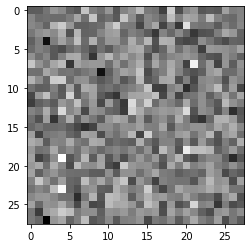

In [755]:
plt.imshow(pic, cmap='gray')